## Datasets
- Os dados sobre Bitcoin, Ibovespa,VIX e Dolar foram obtido no site Yahoo Finance
- Taxa Selic - Dados diários;Filtros aplicados: Data inicial: 01/11/2013 / Data final: 02/09/2022. <br>
LINK https://www.bcb.gov.br/htms/SELIC/SELICdiarios.asp?frame=1

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mpdates
import warnings
warnings.filterwarnings('ignore')
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score

### Constants and Parameters

In [2]:
dfColumns = ['date','open', 'high', 'low','close','tickvol','volume','spread']
newColumns = ['open', 'high', 'low', 'close']
col15 = ['open','d-5_high','d-5_low','d-4_high','d-4_low','d-3_high','d-3_low','d-2_high','d-2_low','d-1_high','d-1_low','EMA_high','EMA_low','UB_close','LB_close']
col25 = ['open','d-5_open','d-5_high','d-5_low','d-5_close','d-4_open','d-4_high','d-4_low','d-4_close','d-3_open','d-3_high','d-3_low','d-3_close','d-2_open','d-2_high','d-2_low','d-2_close','d-1_open','d-1_high','d-1_low','d-1_close','EMA_high' ,'EMA_low','UB_close','LB_close']
DAYS = 5
# precisava de dados mais antigos
TRAIN_BEGIN = '2017.08.01' ## errei a data  era pra ser '2017.08.01' porém o dataset só possui dados de '2017.08.01' em diante e portanto não tem como conseguir valores de média móvel
TRAIN_END = '2020.05.31'
TEST_BEGIN = '2020.06.01'
TEST_END = '2021.06.01'

TIMES = 30

### Auxiliary functions

In [3]:
def calculateEMA(df, n, columns):
    """
    returns an n period exponential moving average for
    the time series s

    pd.Dataframe df: is the original dataframe - it needs to contain a 'Close' named column
    int          n: is the number of periods to consider in the calculus

    returns a dataframe with a new column containing the MME
    """
    
    k  = 2 / (n+1)
    for column in columns:
        EMAcolumn = 'EMA_'+column

        df[EMAcolumn] = df[column]
        df[EMAcolumn].iloc[n-1] = df[column].iloc[0:n-2].mean()

        for i in range(n, len(df)):
            df[EMAcolumn].iloc[i] = (df[column].iloc[i] - df[EMAcolumn].iloc[i-1])*k + df[EMAcolumn].iloc[i-1]
            #MME = (Close[i] - MME[i-1])*k + MME[i-1] 
     
    #The following function makes all the hardwork. However I'll keep it commented, once I've already implemented the calculation
    #f['pandasEMA'] = df['close'].ewm(span=5, adjust=False).mean()
    
    return df

def calculateBB(df, n, columns):
    for column in columns:
        ma = df['close'].rolling(window=n).mean()
        std = df['close'].rolling(window=n).std() 
    
        df['UB_'+column] = ma + (std * 2)
        df['LB_'+column] = ma - (std * 2)
    
    return df

def removeColumns(df, columns):
    df = df.drop(columns, axis=1)
    return df

def addPreviousDays(df, days, columns):
    auxDf = df
    for day in range(1,days+1):
        for column in columns:
            colName = 'd-'+str(day)+'_'+column
            df[colName] = auxDf[column].shift(day)
    return df

def getPeriod(df, begin, end, resetIndex = False):
    """
    returns the df in the chosen interval
    
    Object begin: Start date forrmated as 'yyyy.mm.dd'
    Object   end: end date 'yyyy.mm.dd'

    returns a dataframe with the historic of the selected period
    """
    indexBegin = df[df['date']>=begin].index[0]
    indexEnd = df[df['date']>=end].index[0]
    if (resetIndex):
        return df[(df.index >= indexBegin) & (df.index <= indexEnd)].reset_index(drop=True)
    else: 
        return df[(df.index >= indexBegin) & (df.index <= indexEnd)]
    
def mape(actual, pred): 
    actual, pred = np.array(actual), np.array(pred)
    return np.mean(np.abs((actual - pred) / actual)) * 100, np.std(np.abs((actual - pred) / actual)) * 100

def mae(actual, pred): 
    actual, pred = np.array(actual), np.array(pred)
    return np.mean(np.abs(actual - pred)), np.std(np.abs(actual - pred))

def Normalize(df):
    date = df['date']
    maxVal = df[['high', 'low']].max()
    normalized = removeColumns(df,['date'])/(removeColumns(df,['date']).max()*2)
    
    
    df.loc[:, df.columns != 'date'] = normalized
    
    return df, maxVal

def createDate(day, month, year):
    if(day >= 10):
        day = str(day)
    else:
        day = '0' + str(day)
    
    if(month < 10):
        month = '0' + str(month)
    else:
        month = str(month)
        
    year = str(year)
    date = year + '.' + month + '.' + day
    
    return date

def getDate(date):
    
    split = date.split('.')
    
    year = int(split[0])
    month = int(split[1])
    day = int(split[2])
    
    return year, month, day
 
def printResult(error, column):
    print(column+': '+str(error[0].round(2))+' +- '+str(error[1].round(2)) + ' %')

### Opening the dataset

In [4]:
# tickers = ['PETR4','VALE3','WEGE3','BBDC4','ITUB4']
tickers = ['ABEV3','BBDC4','EGIE3','ITUB4','JBSS3','PETR4']
dfs = {}
for ticker in tickers:
    dfTemp = pd.read_csv(f'../Data/{ticker}_Daily.csv', sep = "\t")
    dfTemp.columns = dfColumns
    dfs[ticker] = removeColumns(dfTemp, ['tickvol', 'volume','spread'])
    




In [5]:
for ticker in dfs:
    dfs[ticker] = calculateEMA(dfs[ticker],DAYS,newColumns)
    dfs[ticker] = calculateBB(dfs[ticker],DAYS,newColumns)
    dfs[ticker] = addPreviousDays(dfs[ticker],DAYS, newColumns)
dfTemp = dfs[tickers[0]]
print(dfTemp.columns, dfTemp.columns.size)

Index(['date', 'open', 'high', 'low', 'close', 'EMA_open', 'EMA_high',
       'EMA_low', 'EMA_close', 'UB_open', 'LB_open', 'UB_high', 'LB_high',
       'UB_low', 'LB_low', 'UB_close', 'LB_close', 'd-1_open', 'd-1_high',
       'd-1_low', 'd-1_close', 'd-2_open', 'd-2_high', 'd-2_low', 'd-2_close',
       'd-3_open', 'd-3_high', 'd-3_low', 'd-3_close', 'd-4_open', 'd-4_high',
       'd-4_low', 'd-4_close', 'd-5_open', 'd-5_high', 'd-5_low', 'd-5_close'],
      dtype='object') 37


In [6]:
initialDfs = {}
for ticker in dfs:
    initialDfs[ticker] = getPeriod(dfs[ticker], TRAIN_BEGIN,TEST_END, True)
initialDfs[tickers[0]]

,date,open,high,low,close,EMA_open,EMA_high,EMA_low,EMA_close,UB_open,...,d-3_low,d-3_close,d-4_open,d-4_high,d-4_low,d-4_close,d-5_open,d-5_high,d-5_low,d-5_close
0,2017.08.01,16.90,17.02,16.84,16.97,16.776687,16.967848,16.733464,16.850719,17.105666,...,16.65,16.86,16.63,16.71,16.54,16.61,16.65,16.75,16.62,16.65
1,2017.08.02,16.91,17.14,16.88,17.11,16.821125,17.025232,16.782310,16.937146,17.152148,...,16.69,16.85,16.65,17.12,16.65,16.86,16.63,16.71,16.54,16.61
2,2017.08.03,17.08,17.11,16.96,16.99,16.907417,17.053488,16.841540,16.954764,17.163196,...,16.82,16.89,16.72,16.95,16.69,16.85,16.65,17.12,16.65,16.86
3,2017.08.04,17.01,17.03,16.85,16.99,16.941611,17.045659,16.844360,16.966509,17.147480,...,16.84,16.97,16.84,17.08,16.82,16.89,16.72,16.95,16.69,16.85
4,2017.08.07,16.98,17.14,16.90,17.07,16.954407,17.077106,16.862907,17.001006,17.147326,...,16.88,17.11,16.90,17.02,16.84,16.97,16.84,17.08,16.82,16.89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,2021.05.26,17.16,17.21,16.75,16.89,17.033578,17.123876,16.769824,16.937146,17.118841,...,16.66,17.03,16.97,17.05,16.79,16.96,16.79,17.02,16.75,16.98
942,2021.05.27,16.80,17.10,16.63,17.10,16.955719,17.115917,16.723216,16.991431,17.172532,...,16.86,17.04,16.97,17.04,16.66,17.03,16.97,17.05,16.79,16.96
943,2021.05.28,17.01,17.34,16.92,17.26,16.973813,17.190612,16.788811,17.080954,17.331806,...,16.95,17.03,17.03,17.15,16.86,17.04,16.97,17.04,16.66,17.03
944,2021.05.31,17.15,17.35,17.12,17.35,17.032542,17.243741,16.899207,17.170636,17.491677,...,16.75,16.89,17.17,17.21,16.95,17.03,17.03,17.15,16.86,17.04


### Carregando dataset de indicadores externos

In [7]:

# obtendo indicadores externos
def allColumnsToLower(df):
    columnHash = {}
    for columnName in df.columns:
        columnHash[columnName] = columnName.lower()
    df = df.rename(columnHash, axis=1) 
    return df

def parseDate(str:str):
    return str.replace('-','.')


externalIndexes = ['^VIX','^BVSP','BRL=X','BTC-USD']
dfsIndexes = {}
for ticker in externalIndexes:    
    dfTemp = pd.read_csv(f'../Data/externalIndex/{ticker}.csv', sep = ",")
    dfTemp = dfTemp.dropna()
    dfTemp = allColumnsToLower(dfTemp)
    dfTemp = removeColumns(dfTemp, ['adj close', 'volume'])
    dfTemp['date'] = dfTemp['date'].map(parseDate)
    dfsIndexes[ticker] = dfTemp.copy()

In [8]:
for ticker in dfsIndexes:
    dfsIndexes[ticker] = calculateEMA(dfsIndexes[ticker],DAYS,newColumns)
    dfsIndexes[ticker] = calculateBB(dfsIndexes[ticker],DAYS,newColumns)
    dfsIndexes[ticker] = addPreviousDays(dfsIndexes[ticker],DAYS, newColumns)

#### Experimento 01: Utilizando Random Forest Sem indicadores externos
##### Hipóteses plausíveis de serem testadas
1. Se construirmos um regressor só para a baixa e um regressor só para alta melhoramos nossa precisão?

In [7]:
def exp1(df, inputColumns = [], printPredictValues = False, runBackTesting = False, **regressorParams):
    df_train = getPeriod(df, TRAIN_BEGIN, TRAIN_END)
    df_test = getPeriod(df, TEST_BEGIN, TEST_END)
    if(inputColumns == []):
        x_train = df_train.drop(['date', 'high', 'low', 'close'], axis=1)
        y_train = df_train[['high','low']]

        x_test = df_test.drop(['date', 'high', 'low', 'close'], axis=1)
        y_test = df_test[['high','low']]
    else:
        trainColumns = [column for column in inputColumns if not column in ['date']]
        x_train = df_train[trainColumns]
        y_train = df_train[['high','low']]

        x_test = df_test[inputColumns]
        y_test = df_test[['high','low']]


    rf = RandomForestRegressor(n_estimators = 500, **regressorParams)
    rf.fit(x_train, y_train);

    y_pred = rf.predict(x_test)

    
    if printPredictValues:
        # plotting the points
        plt.figure(figsize=(10,5),dpi = 1000)
        
        plt.plot(x_train.index, y_train['low'], label='real-low', color='tab:red', lw = 0.3)
        plt.plot(x_train.index, y_train['high'], label='real-high', color='tab:green', lw = 0.3)
        plt.axvline(x = x_train.index.size, color = 'b', label = 'train|test', lw = 0.3)

        plt.plot(x_test.index, y_test['low'], label='real-low', color='tab:red', lw = 0.3)
        plt.plot(x_test.index, y_test['high'], label='real-high', color='tab:green', lw = 0.3)
        plt.plot(x_test.index, y_pred[:,1], label='pred-low', color='tab:red', linestyle='dotted', lw = 0.3)
        plt.plot(x_test.index, y_pred[:,0], label='pred-high', color='tab:green', linestyle='dotted', lw = 0.3)
        # plt.plot(x_test.index, y_pred)    
        plt.xlabel('x - axis')
        plt.ylabel('y - axis')
        plt.title('Valor Predito e Valor Real')
        
        # function to show the plot
        plt.legend()
        plt.show()
        
    if runBackTesting:
        pass
    
    errorMax = mape(y_test['high'],y_pred[:,0])
    errorMin = mape(y_test['low'],y_pred[:,1])
    
    resultTest = df_test
    resultTest['pred_low'] = y_pred[:,1]
    resultTest['pred_high'] = y_pred[:,0]
    return errorMax, errorMin, rf, x_train.columns, resultTest

In [11]:

def runModelNTimes(df, phrase, columnInput = [], times = TIMES):
    errorsMax = []
    errorsMin = []
    for i in range(1, times+1):
        if(columnInput == []):
            errorMax, errorMin, rf, _, _  = exp1(df)
        else: 
            errorMax, errorMin, rf, _ , _= exp1(df, columnInput)
            
        errorsMax.append(errorMax[0])
        errorsMin.append(errorMin[0])
        
    
    errorsMax = np.array(errorsMax)
    errorsMin = np.array(errorsMin)
    print(phrase)
    printResult((errorsMax.mean(),errorsMax.std()), 'High')
    printResult((errorsMin.mean(),errorsMin.std()), 'Low')


for ticker in initialDfs:
    print(f"Analisando {ticker}")    
    runModelNTimes(initialDfs[ticker], f'{ticker} 15 Variables', col15) 
    runModelNTimes(initialDfs[ticker], f'{ticker} 25 Variables', col25) 
    runModelNTimes(initialDfs[ticker], f'{ticker} Variables') 
    print('\n')


Analisando ABEV3
ABEV3 15 Variables
High: 1.26 +- 0.02 %
Low: 2.28 +- 0.05 %
ABEV3 25 Variables
High: 1.32 +- 0.02 %
Low: 2.31 +- 0.06 %
ABEV3 Variables
High: 1.3 +- 0.02 %
Low: 2.23 +- 0.06 %


Analisando BBDC4
BBDC4 15 Variables
High: 1.01 +- 0.01 %
Low: 0.98 +- 0.0 %
BBDC4 25 Variables
High: 1.02 +- 0.0 %
Low: 0.97 +- 0.01 %
BBDC4 Variables
High: 0.98 +- 0.0 %
Low: 0.95 +- 0.0 %


Analisando EGIE3
EGIE3 15 Variables
High: 0.77 +- 0.0 %
Low: 0.71 +- 0.01 %
EGIE3 25 Variables
High: 0.79 +- 0.0 %
Low: 0.72 +- 0.0 %
EGIE3 Variables
High: 0.75 +- 0.0 %
Low: 0.68 +- 0.0 %


Analisando ITUB4
ITUB4 15 Variables
High: 0.97 +- 0.0 %
Low: 0.96 +- 0.01 %
ITUB4 25 Variables
High: 0.97 +- 0.0 %
Low: 0.95 +- 0.01 %
ITUB4 Variables
High: 0.98 +- 0.0 %
Low: 0.93 +- 0.01 %


Analisando JBSS3
JBSS3 15 Variables
High: 1.43 +- 0.01 %
Low: 1.7 +- 0.01 %
JBSS3 25 Variables
High: 1.47 +- 0.01 %
Low: 1.65 +- 0.01 %
JBSS3 Variables
High: 1.46 +- 0.01 %
Low: 1.63 +- 0.01 %


Analisando PETR4
PETR4 15 Variable

### Grid Search 
#### Não faz sentido realizar o grid search novamente em cada ativo

### Mostrando influências das features para o Random Forest Regressor (sem indicador externo)

Analisando ABEV3


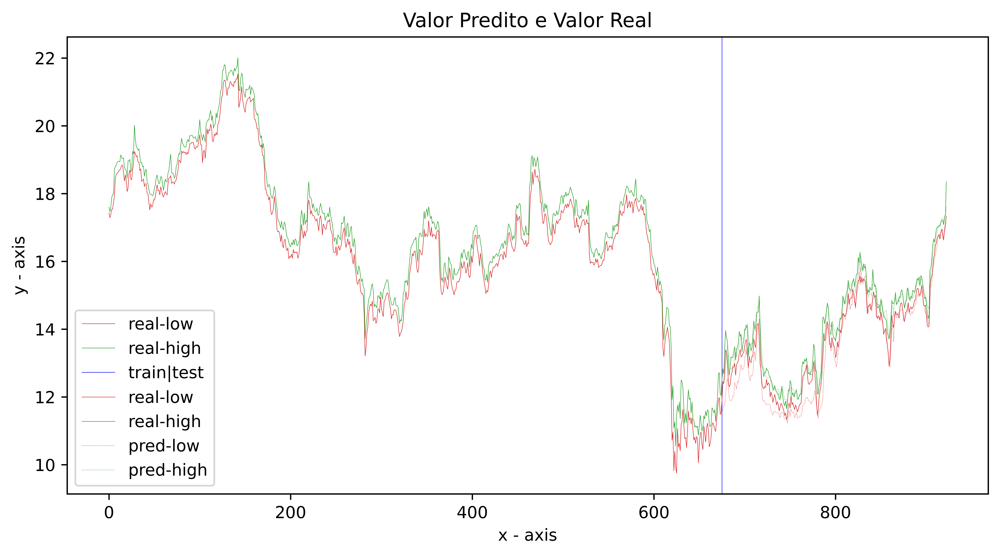

      Feature  Importance
0        open   56.064988
16  d-1_close   24.413655
4   EMA_close    6.060981
14   d-1_high    2.649778
2    EMA_high    2.165908
15    d-1_low    1.350659
3     EMA_low    1.021266
12   LB_close    1.016145
8     LB_high    0.950263
1    EMA_open    0.909317
10     LB_low    0.859777
6     LB_open    0.849312
13   d-1_open    0.416658
20  d-2_close    0.264166
19    d-2_low    0.261780
17   d-2_open    0.140453
23    d-3_low    0.122563
28  d-4_close    0.094284
18   d-2_high    0.092284
21   d-3_open    0.046728
11   UB_close    0.036162
26   d-4_high    0.034932
24  d-3_close    0.034801
7     UB_high    0.030454
9      UB_low    0.025833
5     UB_open    0.014918
29   d-5_open    0.011592
31    d-5_low    0.011543
30   d-5_high    0.011523
22   d-3_high    0.010057
25   d-4_open    0.009529
32  d-5_close    0.009054
27    d-4_low    0.008638
Analisando BBDC4


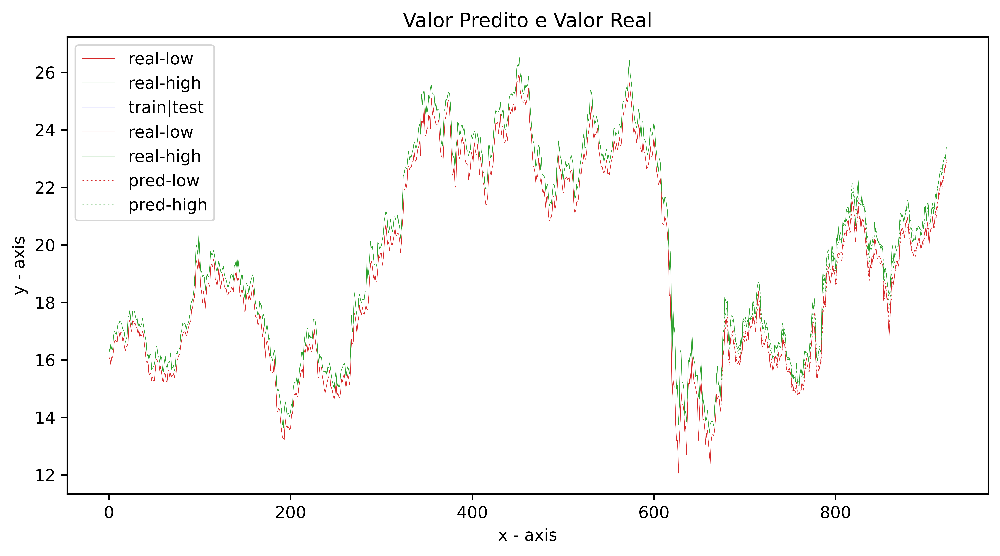

      Feature  Importance
0        open   45.975032
4   EMA_close   23.050557
16  d-1_close    8.058507
2    EMA_high    4.683389
13   d-1_open    3.624035
3     EMA_low    3.428567
1    EMA_open    3.137569
15    d-1_low    1.492637
14   d-1_high    1.380705
17   d-2_open    0.998747
10     LB_low    0.871183
6     LB_open    0.859238
8     LB_high    0.706542
5     UB_open    0.507903
12   LB_close    0.377335
20  d-2_close    0.178088
21   d-3_open    0.173298
18   d-2_high    0.172936
23    d-3_low    0.170589
29   d-5_open    0.016128
9      UB_low    0.014900
11   UB_close    0.013596
7     UB_high    0.013379
31    d-5_low    0.011461
27    d-4_low    0.010916
30   d-5_high    0.010196
28  d-4_close    0.010105
22   d-3_high    0.009527
32  d-5_close    0.009345
25   d-4_open    0.008863
26   d-4_high    0.008786
19    d-2_low    0.008370
24  d-3_close    0.007571
Analisando EGIE3


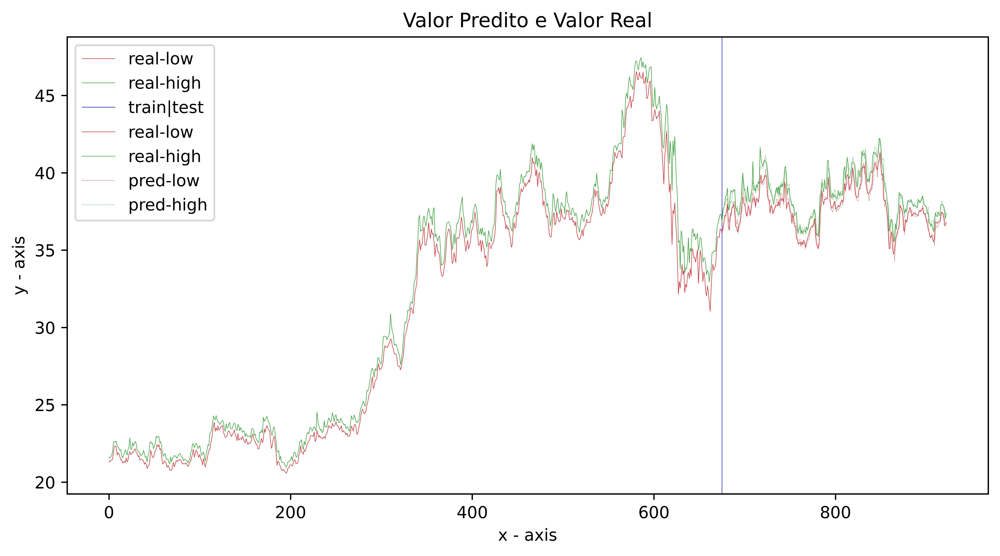

      Feature  Importance
0        open    6.590357
16  d-1_close    6.382076
4   EMA_close    5.828392
3     EMA_low    5.821607
17   d-2_open    5.727077
19    d-2_low    4.909802
20  d-2_close    3.930086
1    EMA_open    3.636750
2    EMA_high    3.469758
5     UB_open    3.435893
32  d-5_close    3.338144
28  d-4_close    3.277552
23    d-3_low    3.273555
15    d-1_low    3.016426
7     UB_high    2.887294
31    d-5_low    2.845038
24  d-3_close    2.599539
13   d-1_open    2.537241
14   d-1_high    2.462030
10     LB_low    2.446738
25   d-4_open    2.288496
8     LB_high    2.287271
11   UB_close    1.998663
6     LB_open    1.948553
21   d-3_open    1.947481
27    d-4_low    1.915194
12   LB_close    1.789306
22   d-3_high    1.424847
9      UB_low    1.337791
30   d-5_high    1.305329
18   d-2_high    1.121329
26   d-4_high    1.111516
29   d-5_open    1.108872
Analisando ITUB4


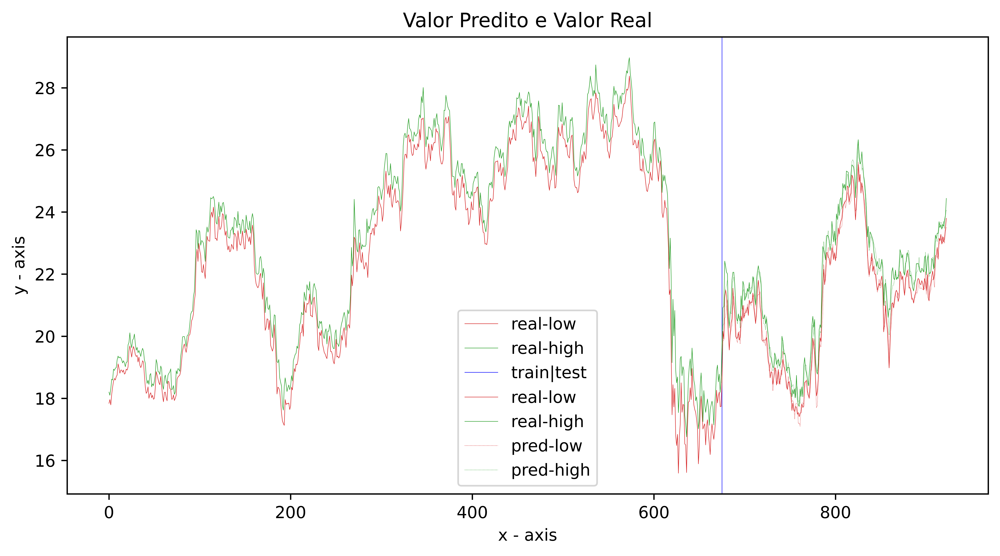

      Feature  Importance
0        open   91.764161
4   EMA_close    3.138365
16  d-1_close    2.626144
2    EMA_high    0.697668
3     EMA_low    0.512941
10     LB_low    0.350154
15    d-1_low    0.269341
6     LB_open    0.192118
14   d-1_high    0.034063
20  d-2_close    0.030977
8     LB_high    0.030123
7     UB_high    0.028919
5     UB_open    0.028473
11   UB_close    0.026969
9      UB_low    0.026454
12   LB_close    0.025722
29   d-5_open    0.016988
13   d-1_open    0.014816
32  d-5_close    0.014547
22   d-3_high    0.014504
18   d-2_high    0.013907
21   d-3_open    0.013826
30   d-5_high    0.013663
19    d-2_low    0.012888
1    EMA_open    0.012650
17   d-2_open    0.012206
24  d-3_close    0.012203
31    d-5_low    0.011817
25   d-4_open    0.011262
27    d-4_low    0.011256
28  d-4_close    0.011054
23    d-3_low    0.009999
26   d-4_high    0.009825
Analisando JBSS3


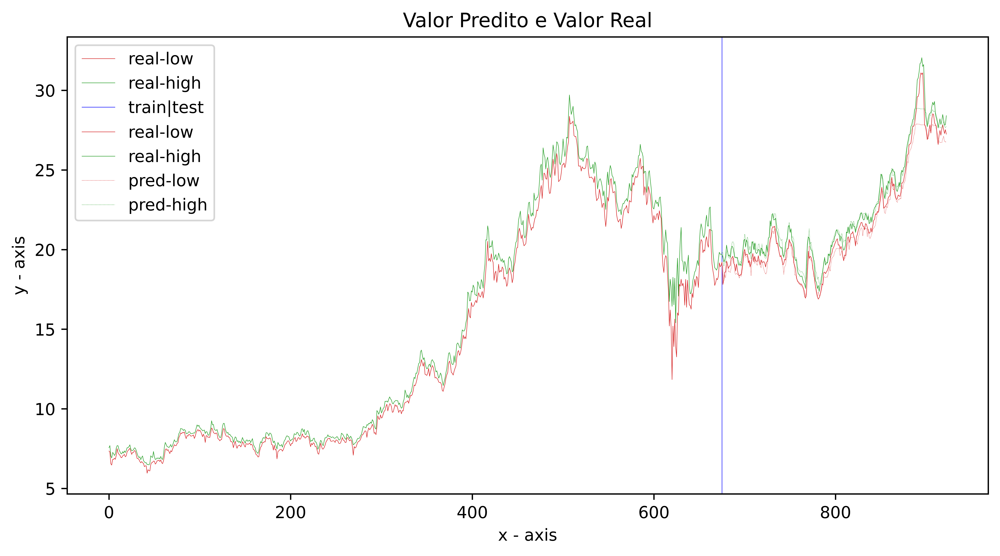

      Feature  Importance
0        open   47.143253
3     EMA_low   10.888208
25   d-4_open    4.848016
4   EMA_close    4.288639
6     LB_open    3.336019
28  d-4_close    3.299004
12   LB_close    3.166745
10     LB_low    2.971487
8     LB_high    2.263141
1    EMA_open    1.919698
20  d-2_close    1.762165
17   d-2_open    1.428922
30   d-5_high    1.260558
2    EMA_high    1.240817
16  d-1_close    1.203524
7     UB_high    0.983508
27    d-4_low    0.951767
26   d-4_high    0.924269
32  d-5_close    0.893040
15    d-1_low    0.652033
9      UB_low    0.629303
11   UB_close    0.591774
14   d-1_high    0.573781
18   d-2_high    0.542633
5     UB_open    0.464392
19    d-2_low    0.447650
24  d-3_close    0.366972
22   d-3_high    0.358319
23    d-3_low    0.251523
13   d-1_open    0.159282
29   d-5_open    0.081643
21   d-3_open    0.071768
31    d-5_low    0.036148
Analisando PETR4


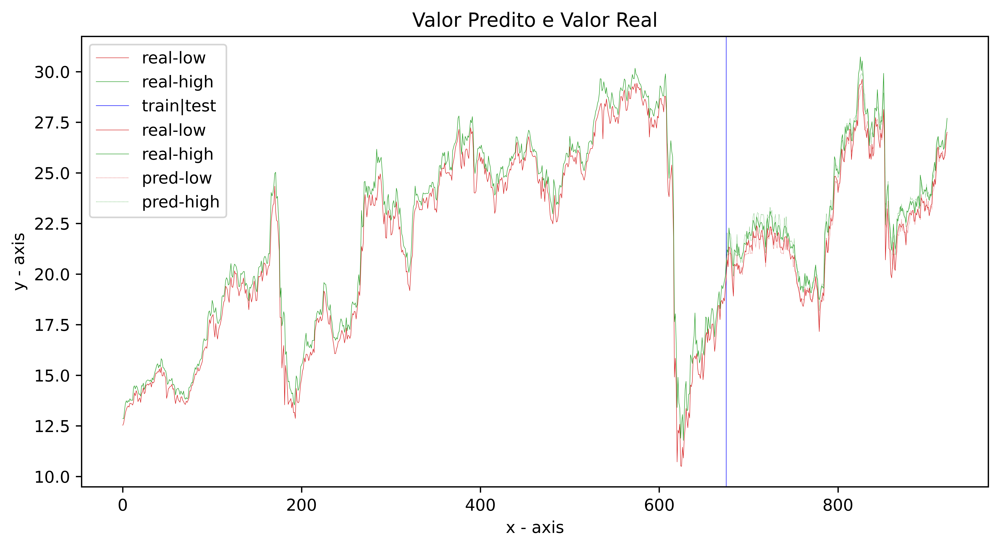

      Feature  Importance
0        open   91.880379
4   EMA_close    2.427801
16  d-1_close    1.885462
3     EMA_low    1.384961
2    EMA_high    0.863040
14   d-1_high    0.521034
15    d-1_low    0.221299
11   UB_close    0.178374
19    d-2_low    0.139820
8     LB_high    0.077878
10     LB_low    0.066270
17   d-2_open    0.047065
12   LB_close    0.043007
1    EMA_open    0.038188
6     LB_open    0.031361
5     UB_open    0.020516
7     UB_high    0.015445
26   d-4_high    0.013711
9      UB_low    0.013700
13   d-1_open    0.013191
20  d-2_close    0.012976
22   d-3_high    0.010920
18   d-2_high    0.010428
25   d-4_open    0.010022
24  d-3_close    0.009707
28  d-4_close    0.008685
23    d-3_low    0.008494
21   d-3_open    0.008156
31    d-5_low    0.007882
30   d-5_high    0.007807
29   d-5_open    0.007774
27    d-4_low    0.007771
32  d-5_close    0.006876


In [16]:
for ticker in initialDfs:
    print(f"Analisando {ticker}")
    _,_,rf,xTrainColumns, dataFrameTeste = exp1(initialDfs[ticker], printPredictValues=True)

    featureImp = []
    for feat, importance in zip(xTrainColumns, rf.feature_importances_):  
        temp = [feat, importance*100]
        featureImp.append(temp)

    fT_df = pd.DataFrame(featureImp, columns = ['Feature', 'Importance'])
    print (fT_df.sort_values('Importance', ascending = False))

### Mostrar influência de outros indicadores técnicos

In [168]:
initialDfs[ticker].columns

Index(['date', 'open', 'high', 'low', 'close', 'EMA_open', 'EMA_high',
       'EMA_low', 'EMA_close', 'UB_open', 'LB_open', 'UB_high', 'LB_high',
       'UB_low', 'LB_low', 'UB_close', 'LB_close', 'd-1_open', 'd-1_high',
       'd-1_low', 'd-1_close', 'd-2_open', 'd-2_high', 'd-2_low', 'd-2_close',
       'd-3_open', 'd-3_high', 'd-3_low', 'd-3_close', 'd-4_open', 'd-4_high',
       'd-4_low', 'd-4_close', 'd-5_open', 'd-5_high', 'd-5_low', 'd-5_close',
       'OSCILADOR%K_5_close'],
      dtype='object')

Analisando ABEV3


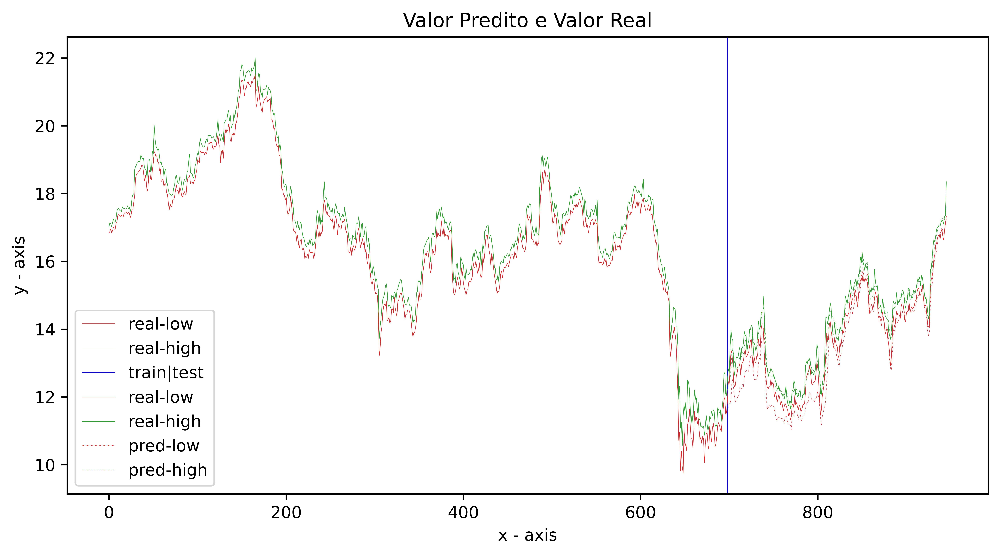

                     Feature  Importance
0                       open   53.469121
16                 d-1_close   22.620405
45               EMA_5_close    2.888946
14                  d-1_high    2.740563
4                  EMA_close    2.547810
15                   d-1_low    1.150841
56  BBANDS_5_close-BB_MIDDLE    1.070584
54     BBANDS_5_low-BB_LOWER    1.064199
2                   EMA_high    0.925602
53    BBANDS_5_low-BB_MIDDLE    0.745615
47   BBANDS_5_open-BB_MIDDLE    0.736408
36                EMA_21_low    0.694668
50   BBANDS_5_high-BB_MIDDLE    0.692035
43                EMA_5_high    0.640628
39                EMA_9_high    0.624811
40                 EMA_9_low    0.587431
48    BBANDS_5_open-BB_LOWER    0.530892
44                 EMA_5_low    0.528692
3                    EMA_low    0.454815
57   BBANDS_5_close-BB_LOWER    0.445111
Analisando BBDC4


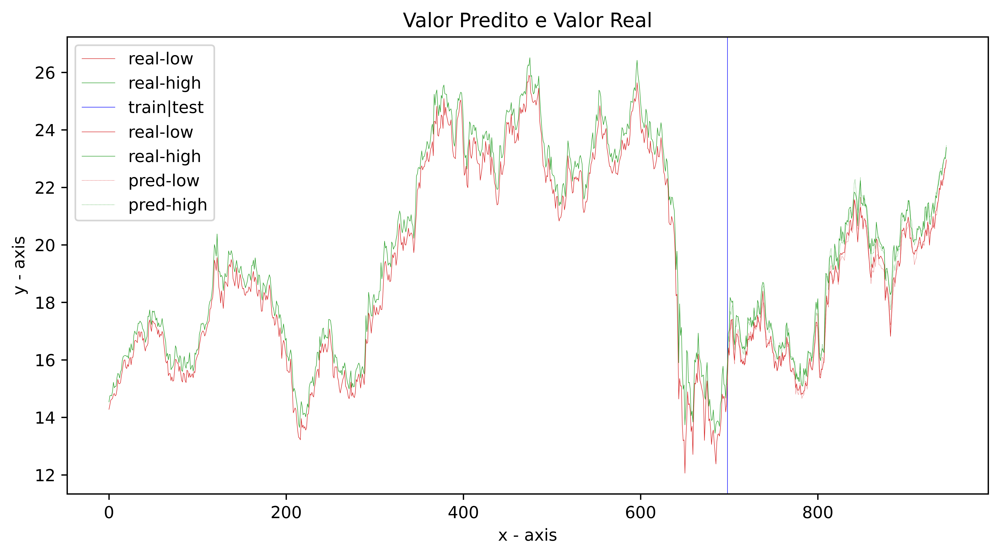

                     Feature  Importance
0                       open   36.914084
48    BBANDS_5_open-BB_LOWER   13.520987
4                  EMA_close   10.623194
45               EMA_5_close    7.100231
16                 d-1_close    3.707737
53    BBANDS_5_low-BB_MIDDLE    2.485195
13                  d-1_open    2.305366
43                EMA_5_high    2.165790
56  BBANDS_5_close-BB_MIDDLE    2.150176
54     BBANDS_5_low-BB_LOWER    1.960057
47   BBANDS_5_open-BB_MIDDLE    1.826486
50   BBANDS_5_high-BB_MIDDLE    1.816642
3                    EMA_low    1.520390
44                 EMA_5_low    1.369913
2                   EMA_high    1.369051
1                   EMA_open    1.334047
42                EMA_5_open    0.995624
17                  d-2_open    0.831374
41               EMA_9_close    0.826280
15                   d-1_low    0.780331
Analisando EGIE3


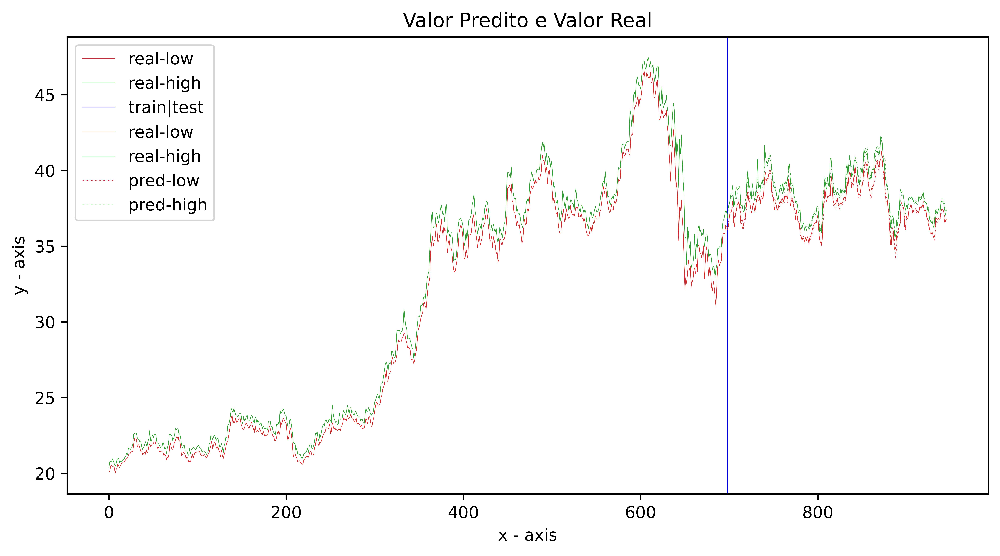

                   Feature  Importance
0                     open    6.411210
36              EMA_21_low    4.135206
16               d-1_close    3.440794
28               d-4_close    3.312581
23                 d-3_low    3.136965
34             EMA_21_open    3.129618
14                d-1_high    2.798046
3                  EMA_low    2.739122
48  BBANDS_5_open-BB_LOWER    2.634456
19                 d-2_low    2.616848
24               d-3_close    2.584833
44               EMA_5_low    2.582391
51  BBANDS_5_high-BB_LOWER    2.444470
35             EMA_21_high    2.406596
4                EMA_close    2.370638
41             EMA_9_close    2.159336
39              EMA_9_high    2.137966
15                 d-1_low    2.060389
49  BBANDS_5_high-BB_UPPER    2.055787
38              EMA_9_open    2.045929
Analisando ITUB4


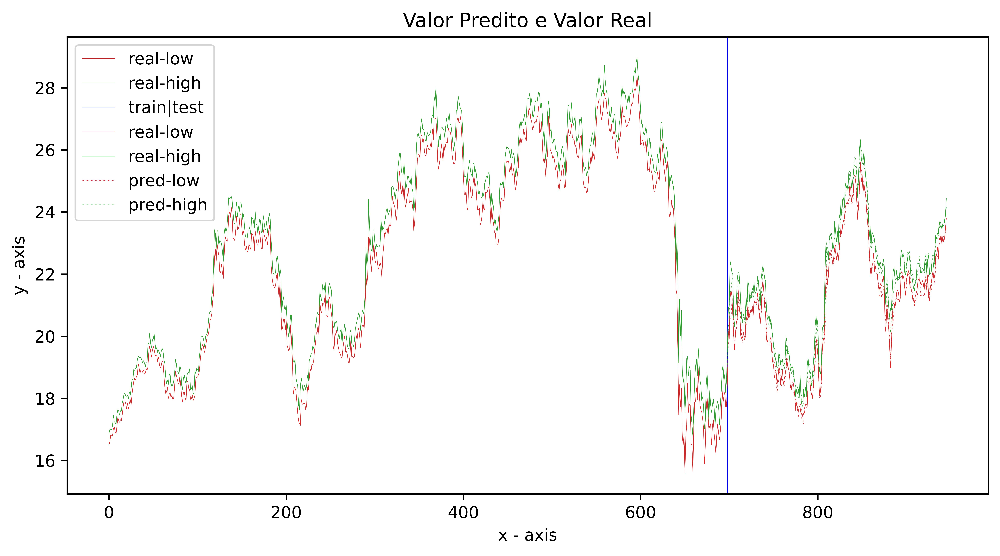

                     Feature  Importance
0                       open   94.972717
16                 d-1_close    1.359214
45               EMA_5_close    0.930775
4                  EMA_close    0.771971
43                EMA_5_high    0.339494
57   BBANDS_5_close-BB_LOWER    0.195412
53    BBANDS_5_low-BB_MIDDLE    0.186719
2                   EMA_high    0.182825
3                    EMA_low    0.138663
54     BBANDS_5_low-BB_LOWER    0.110811
44                 EMA_5_low    0.106002
15                   d-1_low    0.083627
14                  d-1_high    0.049707
33       OSCILADOR%K_5_close    0.041439
47   BBANDS_5_open-BB_MIDDLE    0.038068
56  BBANDS_5_close-BB_MIDDLE    0.035285
60                 RSI_9_low    0.028883
49    BBANDS_5_high-BB_UPPER    0.028509
61               RSI_9_close    0.021638
59                RSI_9_high    0.019693
Analisando JBSS3


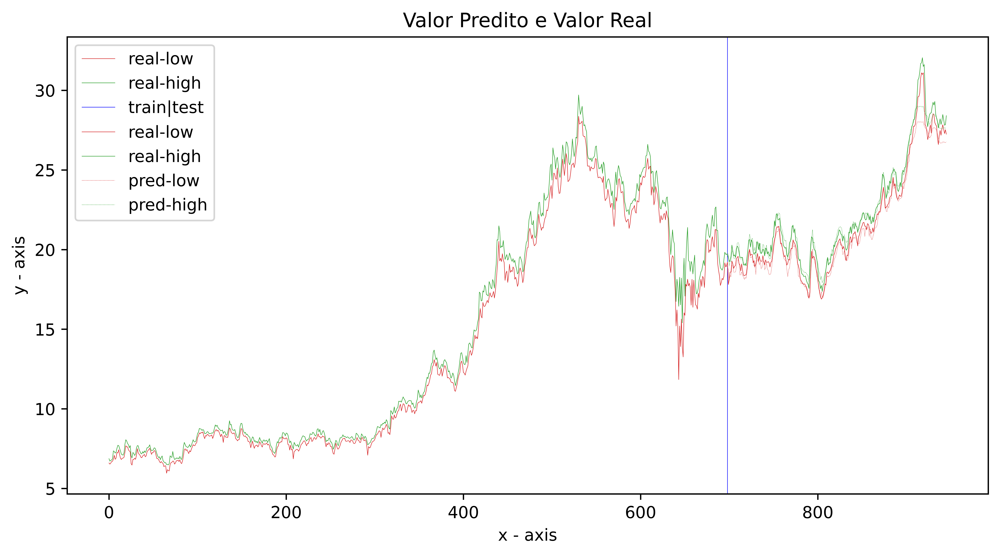

                    Feature  Importance
0                      open   45.450278
44                EMA_5_low    5.764861
3                   EMA_low    4.918759
25                 d-4_open    4.527583
57  BBANDS_5_close-BB_LOWER    3.298073
8                   LB_high    2.808421
10                   LB_low    2.784761
6                   LB_open    2.634297
12                 LB_close    2.598338
28                d-4_close    2.301804
4                 EMA_close    1.855521
20                d-2_close    1.755348
27                  d-4_low    1.564473
19                  d-2_low    1.263360
17                 d-2_open    1.240286
45              EMA_5_close    1.145248
30                 d-5_high    1.075131
35              EMA_21_high    0.935371
16                d-1_close    0.926207
47  BBANDS_5_open-BB_MIDDLE    0.798570
Analisando PETR4


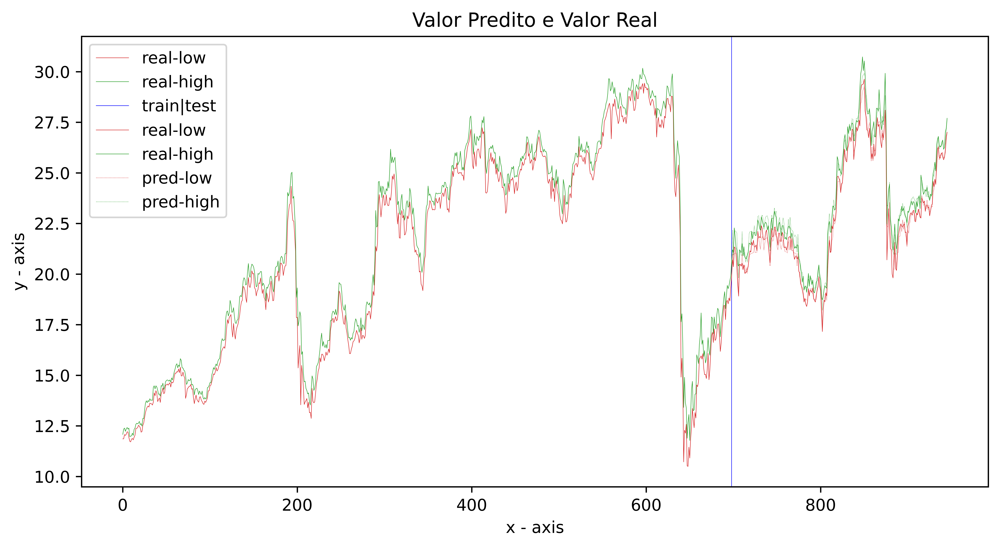

                    Feature  Importance
0                      open   93.316110
4                 EMA_close    1.869271
45              EMA_5_close    1.240406
16                d-1_close    0.881602
3                   EMA_low    0.642497
14                 d-1_high    0.504932
44                EMA_5_low    0.305350
15                  d-1_low    0.198694
43               EMA_5_high    0.185175
1                  EMA_open    0.166936
54    BBANDS_5_low-BB_LOWER    0.104610
19                  d-2_low    0.072889
48   BBANDS_5_open-BB_LOWER    0.042611
17                 d-2_open    0.032425
51   BBANDS_5_high-BB_LOWER    0.029845
49   BBANDS_5_high-BB_UPPER    0.024554
42               EMA_5_open    0.022918
33      OSCILADOR%K_5_close    0.020984
47  BBANDS_5_open-BB_MIDDLE    0.018280
60                RSI_9_low    0.015872


In [170]:
from finta import TA
def calculateIndicatorToOHLC(df,indicatorName, indicatorFunction,period, features=['open', 'high', 'low', 'close']):
    for ohlcColumn in features:
        finalColumName = f'{indicatorName}_{period}_{ohlcColumn}'
        if(indicatorName == 'BBANDS'):
            bb = indicatorFunction(df, column=ohlcColumn, period=period)
            for column in bb.columns:
                df[f'{finalColumName}-{column}'] = bb[column]
        elif(indicatorName == 'OSCILADOR%K'):
            df[finalColumName] = indicatorFunction(df, period=period)
        else:
            df[finalColumName] = indicatorFunction(df,column=ohlcColumn, period=period)
        
for ticker in tickers:
    calculateIndicatorToOHLC(dfs[ticker],'EMA',TA.EMA,period=21)
    calculateIndicatorToOHLC(dfs[ticker],'EMA',TA.EMA,period=9)
    calculateIndicatorToOHLC(dfs[ticker],'EMA',TA.EMA,period=5)
    calculateIndicatorToOHLC(dfs[ticker],'BBANDS',TA.BBANDS,period=5)
    calculateIndicatorToOHLC(dfs[ticker],'RSI',TA.RSI,period=9)
    calculateIndicatorToOHLC(dfs[ticker],'OSCILADOR%K',TA.STOCH,period=5, features=['close'])

initialDfs = {}
for ticker in dfs:
    initialDfs[ticker] = getPeriod(dfs[ticker], TRAIN_BEGIN,TEST_END, True)
initialDfs[tickers[0]]
# print(dfs['BBDC4'])

for ticker in initialDfs:
    print(f"Analisando {ticker}")
    _,_,rf,xTrainColumns, dataFrameTeste = exp1(initialDfs[ticker], printPredictValues=True)

    featureImp = []
    for feat, importance in zip(xTrainColumns, rf.feature_importances_):  
        temp = [feat, importance*100]
        featureImp.append(temp)

    fT_df = pd.DataFrame(featureImp, columns = ['Feature', 'Importance'])
    print (fT_df.sort_values('Importance', ascending = False).head(20))


#### Experimento 02: Utilizando Random Forest com indicadores externos
##### Hipóteses plausíveis de serem testadas

In [13]:
stocksWithExternalIndex = {}
for stockTicker in initialDfs:
    for externalIndexTicker in dfsIndexes:
        key = f'{stockTicker}-{externalIndexTicker}'
        stocksWithExternalIndex[key] = initialDfs[stockTicker].merge(dfsIndexes[externalIndexTicker], how='inner', on='date', suffixes=('', f'_{externalIndexTicker}'))      

#### Verificando importância do Dólar, VIX, BVSP e BTC no Random Forest Regression

In [14]:
for stockIndexTicker in stocksWithExternalIndex:
    print(f"Analisando influencia da feature {stockIndexTicker}")
    bd = stocksWithExternalIndex[stockIndexTicker]
    _,_,rf, trainColumns, _ = exp1(bd)

    # importance = rf.feature_importances_
    featureImp = []
    for feat, importance in zip(trainColumns, rf.feature_importances_):  
        temp = [feat, importance*100]
        featureImp.append(temp)

    fT_df = pd.DataFrame(featureImp, columns = ['Feature', 'Importance'])
    print (fT_df.sort_values('Importance', ascending = False).head(30))

Analisando influencia da feature ABEV3-^VIX
         Feature  Importance
0           open   52.924057
16     d-1_close   25.710321
4      EMA_close    6.934101
14      d-1_high    2.616651
15       d-1_low    2.097269
2       EMA_high    1.691967
8        LB_high    1.123024
12      LB_close    1.071070
3        EMA_low    1.051375
1       EMA_open    0.988295
6        LB_open    0.903500
10        LB_low    0.861237
19       d-2_low    0.396773
13      d-1_open    0.261455
23       d-3_low    0.221928
20     d-2_close    0.209055
24     d-3_close    0.154962
18      d-2_high    0.099104
11      UB_close    0.098792
17      d-2_open    0.074963
5        UB_open    0.065515
28     d-4_close    0.055965
22      d-3_high    0.039532
27       d-4_low    0.037290
32     d-5_close    0.030048
9         UB_low    0.029084
7        UB_high    0.017735
34     high_^VIX    0.016048
67  d-5_low_^VIX    0.014961
36    close_^VIX    0.010960
Analisando influencia da feature ABEV3-^BVSP
           F

### Sistema Proposto

### Grid Search com o modelo proposto

In [29]:
%%capture captured
import sys
import pickle
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

tickerNotAnalyzed= ['VALE3','WEGE3'] 

NUM_ATTEMPTS = 20
samplingRateList = [15,5]
errorMaxList = [0, 0.001, 0.01]
errorMinList = [0, 0.001, 0.01]
stopLossList = [0.005,0.01,0.02]
checkEngulfingList = [True, False]

index = 0
for ticker in initialDfs:
    for samplingRate in samplingRateList:
        for errorMax in errorMaxList:
            for errorMin in errorMinList:
                for stopLoss in stopLossList:
                    for checkEngulfing in checkEngulfingList:
                        key = f'ticker:{ticker}| samplingRate: {samplingRate} | errorMax: {errorMax} | errorMin: {errorMin} | stopLoss: {stopLoss} checkEngulfing:{checkEngulfing}'
                        if(ticker in tickerNotAnalyzed):
                            continue
                        print("###############################################")
                        print(f"Analisando {key}")
                        initialDf = initialDfs[ticker] 
                        dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
                        newColumns = ['open', 'high', 'low', 'close']

                        # df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
                        try:
                            df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M{samplingRate}.csv', sep = "\t")
                        except:
                            print(f"Houve um erro ao carregar arquivo {ticker}_M15.csv")
                        df_INTRA_DAY.columns = dfColumns
                        df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
                        df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

                        finalMoneyList = []
                        annualReturnList = []
                        DDmaxList = []
                        tradesMeanList = []
                        for tries in range(NUM_ATTEMPTS):
                            verbose = tries == NUM_ATTEMPTS-1
                            _, _,rf, trainColumns, testResult = exp1(initialDf)
                            orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runLuizStrategy(
                                df=testResult, 
                                dailyDf=df_INTRA_DAY,
                                Money=100000,
                                stopLoss=stopLoss,
                                errorMax=errorMax,
                                errorMin=errorMin,
                                stdMax=None,
                                stdMin=None,
                                alfa=0.0,
                                beta=0.0,
                                method='martinez',
                                checkEngulfing=checkEngulfing,
                                ticker=ticker,
                                verbose=False
                                )
                            
                            finalMoneyList.append(finalMoney)
                            annualReturnList.append(annualReturn)
                            DDmaxList.append(DDmax)
                            tradesMeanList.append(tradesMean)

                            if(verbose):
                                print(f"Mostrando estatística da {tries+1}º execução")
                                printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
                                printAmountChart(orders, dfDaily, title = f'{index}-{key}', DDDf=DD)
                        gridSearchResult[key] = {
                            "finalMoneyList": finalMoneyList,
                            "annualReturnList": annualReturnList,
                            "DDmaxList": DDmaxList,
                            "tradesMeanList": tradesMeanList,
                        }
                        printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)
                        index+=1
with open('gridSearch_output_full.txt', 'w+') as f:
    f.write(captured.stdout)

ValueError: Length mismatch: Expected axis has 0 elements, new values have 14 elements

In [30]:
with open('gridSearch_output_full.txt', 'w+') as f:
    f.write(captured.stdout)

### Salvando o resultado do gridSearch

In [31]:
import pickle
with open('gridSearchResultFull.dictionary', 'wb') as config_dictionary_file:
  pickle.dump(gridSearchResult, config_dictionary_file)

### Carregando o resultado do GridSearch

In [15]:
import pickle
with open('gridSearchResult.dictionary', 'rb') as config_dictionary_file:
    config_dictionary = pickle.load(config_dictionary_file)

### Salvando resultado do gridSearch em csv

In [32]:
for key in gridSearchResult:
    annualReturnMean = np.array(gridSearchResult[key]['annualReturnList']).mean()
    gridSearchResult[key]['annualReturnMean'] = annualReturnMean
    annualReturnStd = np.array(gridSearchResult[key]['annualReturnList']).std()
    gridSearchResult[key]['annualReturnStd'] = annualReturnStd
    annualReturnDrawnDown = np.array(gridSearchResult[key]['DDmaxList']).mean()
    gridSearchResult[key]['annualReturnDrawnDown'] = annualReturnDrawnDown

gridSearchResultDf = pd.DataFrame(gridSearchResult)
gridSearchResultDfClean = gridSearchResultDf.transpose().sort_values(by=['annualReturnMean'], ascending=False)
gridSearchResultDfClean['annualReturnMean'] = gridSearchResultDfClean['annualReturnMean'].map(lambda x: '%2.2f' % x)
gridSearchResultDfClean['annualReturnStd'] = gridSearchResultDfClean['annualReturnStd'].map(lambda x: '%2.2f' % x)
gridSearchResultDfClean['annualReturnDrawnDown'] = gridSearchResultDfClean['annualReturnDrawnDown'].map(lambda x: '%2.2f' % x)
data_types_dict = {
    "annualReturnMean" : float,
    "annualReturnStd" : float,
    "annualReturnDrawnDown": float
}
gridSearchResultDfClean = gridSearchResultDfClean.astype(data_types_dict)
gridSearchResultDfClean.to_csv('./gridSearchResultFullDf.csv', sep=';', decimal=",")
gridSearchResultDfClean

,finalMoneyList,annualReturnList,DDmaxList,tradesMeanList,annualReturnMean,annualReturnStd,annualReturnDrawnDown
ticker:BBDC4| samplingRate: 15 | errorMax: 0.001 | errorMin: 0.01 | stopLoss: 0.02 checkEngulfing:True,"[171336.09, 176149.19, 154839.93, 158159.53, 1...","[71.4, 76.22, 54.89, 58.21, 78.66, 66.57, 70.0...","[3.11, 4.14, 4.79, 3.86, 2.0, 4.33, 4.34, 4.77...","[0.39, 0.41, 0.39, 0.41, 0.4, 0.41, 0.4, 0.42,...",71.69,8.93,4.00
ticker:BBDC4| samplingRate: 15 | errorMax: 0 | errorMin: 0.01 | stopLoss: 0.02 checkEngulfing:True,"[176709.65, 164802.76, 191368.62, 167669.24, 1...","[76.78, 64.86, 91.45, 67.73, 73.58, 61.07, 64....","[4.25, 4.65, 2.97, 4.1, 2.18, 4.88, 4.12, 2.95...","[0.42, 0.41, 0.42, 0.41, 0.4, 0.43, 0.41, 0.42...",70.56,8.04,4.17
ticker:BBDC4| samplingRate: 5 | errorMax: 0.001 | errorMin: 0.01 | stopLoss: 0.02 checkEngulfing:True,"[163271.95, 187757.75, 161863.74, 155067.5, 17...","[63.33, 87.84, 61.92, 55.11, 78.68, 52.22, 69....","[5.71, 4.3, 5.26, 5.03, 3.76, 4.64, 4.63, 4.33...","[0.53, 0.57, 0.53, 0.54, 0.57, 0.51, 0.57, 0.5...",67.20,14.71,5.10
ticker:BBDC4| samplingRate: 15 | errorMax: 0 | errorMin: 0.01 | stopLoss: 0.01 checkEngulfing:True,"[171650.56, 161481.02, 162413.82, 167745.39, 1...","[71.71, 61.53, 62.47, 67.8, 69.04, 64.86, 51.4...","[3.45, 3.07, 1.98, 2.55, 2.46, 2.97, 3.6, 3.69...","[0.41, 0.39, 0.39, 0.4, 0.41, 0.39, 0.4, 0.41,...",66.21,8.08,3.14
ticker:BBDC4| samplingRate: 5 | errorMax: 0 | errorMin: 0.01 | stopLoss: 0.005 checkEngulfing:True,"[165535.43, 160558.84, 169909.55, 159062.14, 1...","[65.59, 60.61, 69.97, 59.11, 78.92, 53.06, 64....","[4.74, 2.56, 3.43, 3.43, 2.71, 2.72, 2.95, 5.7...","[0.57, 0.58, 0.55, 0.56, 0.57, 0.58, 0.55, 0.5...",65.46,10.87,3.48
...,...,...,...,...,...,...,...
ticker:BBDC4| samplingRate: 15 | errorMax: 0.01 | errorMin: 0.001 | stopLoss: 0.02 checkEngulfing:False,"[76763.81, 75274.59, 76042.35, 82686.57, 78210...","[-23.25, -24.74, -23.97, -17.32, -21.8, -25.54...","[25.94, 24.86, 25.71, 23.67, 24.4, 29.68, 21.4...","[1.0, 1.03, 1.04, 1.01, 1.04, 1.02, 0.98, 1.01...",-22.14,3.27,24.00
ticker:BBDC4| samplingRate: 5 | errorMax: 0.01 | errorMin: 0 | stopLoss: 0.01 checkEngulfing:False,"[72000.72, 80122.0, 73093.98, 87859.95, 76834....","[-28.02, -19.89, -26.92, -12.15, -23.18, -33.9...","[28.84, 23.65, 29.46, 21.75, 25.49, 36.1, 23.4...","[1.4, 1.41, 1.42, 1.41, 1.4, 1.37, 1.34, 1.4, ...",-23.63,5.46,27.49
ticker:BBDC4| samplingRate: 15 | errorMax: 0.01 | errorMin: 0 | stopLoss: 0.01 checkEngulfing:False,"[74562.64, 73819.3, 75442.54, 73761.93, 79151....","[-25.45, -26.2, -24.57, -26.25, -20.86, -30.6,...","[26.64, 26.18, 26.14, 27.76, 21.66, 29.34, 27....","[1.25, 1.2, 1.24, 1.2, 1.17, 1.22, 1.2, 1.21, ...",-23.92,3.41,24.78
ticker:BBDC4| samplingRate: 15 | errorMax: 0.01 | errorMin: 0.001 | stopLoss: 0.01 checkEngulfing:False,"[76587.88, 71437.21, 71949.89, 71740.59, 71720...","[-23.43, -28.58, -28.07, -28.28, -28.3, -28.06...","[28.18, 31.91, 28.43, 28.64, 29.35, 27.73, 24....","[1.17, 1.25, 1.23, 1.18, 1.23, 1.22, 1.17, 1.1...",-26.50,3.44,28.47


### Testando configurações básicas

In [28]:
%%capture captured
import sys
import pickle
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

tickerNotAnalyzed= ['VALE3','WEGE3'] 

# ticker = 'BBDC4'
NUM_ATTEMPTS = 20
samplingRateList = [15, 5]
errorMaxList = [0]
errorMinList = [0]
stopLossList = [0.02]
checkEngulfingList = [True]

index = 0
gridSearchResult = {}
# for ticker in initialDfs:
ticker = 'BBDC4'
for samplingRate in samplingRateList:
    for errorMax in errorMaxList:
        for errorMin in errorMinList:
            for stopLoss in stopLossList:
                for checkEngulfing in checkEngulfingList:
                    key = f'ticker:{ticker}| samplingRate: {samplingRate} | errorMax: {errorMax} | errorMin: {errorMin} | stopLoss: {stopLoss} checkEngulfing:{checkEngulfing}'
                    if(ticker in tickerNotAnalyzed):
                        continue
                    print("###############################################")
                    print(f"Analisando {key}")
                    initialDf = initialDfs[ticker] 
                    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
                    newColumns = ['open', 'high', 'low', 'close']

                    # df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
                    try:
                        df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M{samplingRate}.csv', sep = "\t")
                    except:
                        print(f"Houve um erro ao carregar arquivo {ticker}_M15.csv")
                    df_INTRA_DAY.columns = dfColumns
                    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
                    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

                    finalMoneyList = []
                    annualReturnList = []
                    DDmaxList = []
                    tradesMeanList = []
                    for tries in range(NUM_ATTEMPTS):
                        verbose = tries == NUM_ATTEMPTS-1
                        _, _,rf, trainColumns, testResult = exp1(initialDf)
                        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runLuizStrategy(
                            df=testResult, 
                            dailyDf=df_INTRA_DAY,
                            Money=100000,
                            stopLoss=stopLoss,
                            errorMax=errorMax,
                            errorMin=errorMin,
                            stdMax=None,
                            stdMin=None,
                            alfa=0.0,
                            beta=0.0,
                            method='martinez',
                            checkEngulfing=checkEngulfing,
                            ticker=ticker,
                            verbose=False
                            )
                        
                        finalMoneyList.append(finalMoney)
                        annualReturnList.append(annualReturn)
                        DDmaxList.append(DDmax)
                        tradesMeanList.append(tradesMean)

                        if(verbose):
                            print(f"Mostrando estatística da {tries+1}º execução")
                            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
                            printAmountChart(orders, dfDaily, title = f'{index}-{key}', DDDf=DD)
                    gridSearchResult[key] = {
                        "finalMoneyList": finalMoneyList,
                        "annualReturnList": annualReturnList,
                        "DDmaxList": DDmaxList,
                        "tradesMeanList": tradesMeanList,
                    }
                    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)
                    index+=1

In [26]:
initialDfs['BBDC4']


,date,open,high,low,close,EMA_open,EMA_high,EMA_low,EMA_close,UB_open,...,d-3_low,d-3_close,d-4_open,d-4_high,d-4_low,d-4_close,d-5_open,d-5_high,d-5_low,d-5_close
0,2017.08.01,14.31,14.54,14.28,14.48,14.171058,14.330665,14.081525,14.264074,14.566023,...,13.95,14.08,14.23,14.36,14.04,14.10,14.05,14.25,14.03,14.22
1,2017.08.02,14.46,14.75,14.43,14.68,14.267372,14.470444,14.197683,14.402716,14.840686,...,13.96,14.10,14.22,14.23,13.95,14.08,14.23,14.36,14.04,14.10
2,2017.08.03,14.62,14.77,14.60,14.68,14.384915,14.570296,14.331789,14.495144,14.948799,...,14.04,14.31,14.00,14.13,13.96,14.10,14.22,14.23,13.95,14.08
3,2017.08.04,14.68,14.75,14.63,14.69,14.483276,14.630197,14.431193,14.560096,14.906053,...,14.28,14.48,14.14,14.31,14.04,14.31,14.00,14.13,13.96,14.10
4,2017.08.07,14.70,14.90,14.66,14.86,14.555518,14.720131,14.507462,14.660064,14.947221,...,14.43,14.68,14.31,14.54,14.28,14.48,14.14,14.31,14.04,14.31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,2021.05.26,22.30,22.78,22.26,22.74,22.213483,22.483748,22.032231,22.371031,22.799593,...,21.92,22.40,22.03,22.30,21.97,22.30,21.72,22.09,21.54,22.09
942,2021.05.27,22.74,22.94,22.30,22.87,22.388988,22.635832,22.121487,22.537354,23.065290,...,22.25,22.34,22.24,22.53,21.92,22.40,22.03,22.30,21.97,22.30
943,2021.05.28,22.68,23.04,22.65,22.93,22.485992,22.770555,22.297658,22.668236,23.257201,...,22.07,22.23,22.46,22.58,22.25,22.34,22.24,22.53,21.92,22.40
944,2021.05.31,22.97,23.00,22.69,22.87,22.647328,22.847036,22.428439,22.735491,23.301829,...,22.26,22.74,22.42,22.42,22.07,22.23,22.46,22.58,22.25,22.34


In [22]:
with open('gridSearch_output_basic.txt', 'w+') as f:
    f.write(captured.stdout)

### Testando configurações individuais usando 1-lag-day como regressor

In [11]:
testResult

,date,open,high,low,close,EMA_open,EMA_high,EMA_low,EMA_close,UB_open,...,d-4_open,d-4_high,d-4_low,d-4_close,d-5_open,d-5_high,d-5_low,d-5_close,pred_low,pred_high
697,2020.06.01,14.51,15.32,14.44,15.21,14.697477,15.067233,14.399498,14.839209,15.370659,...,15.74,15.78,14.65,14.76,15.05,15.48,14.81,15.43,14.32486,15.09838
698,2020.06.02,15.51,15.92,15.41,15.89,14.968318,15.351489,14.736332,15.189473,16.124258,...,15.06,15.15,14.74,15.01,15.74,15.78,14.65,14.76,15.12064,15.73602
699,2020.06.03,16.64,16.92,16.42,16.60,15.525545,15.874326,15.297555,15.659648,17.104639,...,14.88,15.11,14.64,14.67,15.06,15.15,14.74,15.01,16.33858,16.84018
700,2020.06.04,16.45,17.04,16.16,16.84,15.833697,16.262884,15.585036,16.053099,17.720895,...,14.67,14.67,14.19,14.56,14.88,15.11,14.64,14.67,16.24022,16.64820
701,2020.06.05,17.95,18.17,17.05,17.15,16.539131,16.898589,16.073358,16.418733,17.904231,...,14.51,15.32,14.44,15.21,14.67,14.67,14.19,14.56,17.00282,17.68350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,2021.05.26,22.30,22.78,22.26,22.74,22.213483,22.483748,22.032231,22.371031,22.799593,...,22.03,22.30,21.97,22.30,21.72,22.09,21.54,22.09,21.95600,22.50940
942,2021.05.27,22.74,22.94,22.30,22.87,22.388988,22.635832,22.121487,22.537354,23.065290,...,22.24,22.53,21.92,22.40,22.03,22.30,21.97,22.30,22.42060,22.93052
943,2021.05.28,22.68,23.04,22.65,22.93,22.485992,22.770555,22.297658,22.668236,23.257201,...,22.46,22.58,22.25,22.34,22.24,22.53,21.92,22.40,22.49486,23.00794
944,2021.05.31,22.97,23.00,22.69,22.87,22.647328,22.847036,22.428439,22.735491,23.301829,...,22.42,22.42,22.07,22.23,22.46,22.58,22.25,22.34,22.67134,23.13454


In [19]:
initialDf['pred_low'] = initialDf['low'].shift(1)
initialDf['pred_low'][0] = initialDf['pred_low'][1]
initialDf['high_low'] = initialDf['high'].shift(1)
initialDf['high_low'][0] = initialDf['high_low'][1]
initialDf

,date,open,high,low,close,EMA_open,EMA_high,EMA_low,EMA_close,UB_open,...,d-4_open,d-4_high,d-4_low,d-4_close,d-5_open,d-5_high,d-5_low,d-5_close,pred_low,high_low
0,2017.08.01,14.31,14.54,14.28,14.48,14.171058,14.330665,14.081525,14.264074,14.566023,...,14.23,14.36,14.04,14.10,14.05,14.25,14.03,14.22,14.28,14.54
1,2017.08.02,14.46,14.75,14.43,14.68,14.267372,14.470444,14.197683,14.402716,14.840686,...,14.22,14.23,13.95,14.08,14.23,14.36,14.04,14.10,14.28,14.54
2,2017.08.03,14.62,14.77,14.60,14.68,14.384915,14.570296,14.331789,14.495144,14.948799,...,14.00,14.13,13.96,14.10,14.22,14.23,13.95,14.08,14.43,14.75
3,2017.08.04,14.68,14.75,14.63,14.69,14.483276,14.630197,14.431193,14.560096,14.906053,...,14.14,14.31,14.04,14.31,14.00,14.13,13.96,14.10,14.60,14.77
4,2017.08.07,14.70,14.90,14.66,14.86,14.555518,14.720131,14.507462,14.660064,14.947221,...,14.31,14.54,14.28,14.48,14.14,14.31,14.04,14.31,14.63,14.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,2021.05.26,22.30,22.78,22.26,22.74,22.213483,22.483748,22.032231,22.371031,22.799593,...,22.03,22.30,21.97,22.30,21.72,22.09,21.54,22.09,22.07,22.42
942,2021.05.27,22.74,22.94,22.30,22.87,22.388988,22.635832,22.121487,22.537354,23.065290,...,22.24,22.53,21.92,22.40,22.03,22.30,21.97,22.30,22.26,22.78
943,2021.05.28,22.68,23.04,22.65,22.93,22.485992,22.770555,22.297658,22.668236,23.257201,...,22.46,22.58,22.25,22.34,22.24,22.53,21.92,22.40,22.30,22.94
944,2021.05.31,22.97,23.00,22.69,22.87,22.647328,22.847036,22.428439,22.735491,23.301829,...,22.42,22.42,22.07,22.23,22.46,22.58,22.25,22.34,22.65,23.04


In [42]:
def oneLagDay(df):
    df_test = getPeriod(df, TEST_BEGIN, TEST_END, resetIndex= True)
    df_test['pred_low'] = df_test['low'].shift(1)
    df_test['pred_low'][0] = df_test['pred_low'][1]
    df_test['pred_high'] = df_test['high'].shift(1)
    df_test['pred_high'][0] = df_test['pred_high'][1]
    return df_test
oneLagDay(initialDf)

,date,open,high,low,close,EMA_open,EMA_high,EMA_low,EMA_close,UB_open,...,d-4_open,d-4_high,d-4_low,d-4_close,d-5_open,d-5_high,d-5_low,d-5_close,pred_low,pred_high
0,2020.06.01,19.50,19.89,19.35,19.67,19.114789,19.515257,18.833676,19.338674,19.963541,...,19.33,19.44,18.70,19.03,18.85,18.92,18.63,18.85,19.35,19.89
1,2020.06.02,20.08,20.70,19.93,20.70,19.436526,19.910171,19.199117,19.792450,20.917675,...,19.16,19.28,18.53,19.28,19.33,19.44,18.70,19.03,19.35,19.89
2,2020.06.03,21.15,21.20,20.71,20.77,20.007684,20.340114,19.702745,20.118300,21.421992,...,19.05,19.43,18.82,19.13,19.16,19.28,18.53,19.28,19.93,20.70
3,2020.06.04,20.69,21.07,20.36,20.73,20.235123,20.583409,19.921830,20.322200,21.470431,...,18.91,19.68,18.67,19.68,19.05,19.43,18.82,19.13,20.71,21.20
4,2020.06.05,21.57,22.28,21.34,21.38,20.680082,21.148940,20.394553,20.674800,21.881503,...,19.50,19.89,19.35,19.67,18.91,19.68,18.67,19.68,20.36,21.07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
244,2021.05.26,25.91,26.18,25.65,26.09,26.114791,26.354219,25.760657,26.042263,26.470349,...,26.15,26.28,25.72,25.93,25.85,26.35,25.80,26.15,25.78,26.62
245,2021.05.27,26.08,26.25,25.77,25.91,26.103194,26.319479,25.763771,25.998175,26.471798,...,26.08,26.31,25.94,25.95,26.15,26.28,25.72,25.93,25.65,26.18
246,2021.05.28,26.20,27.02,26.15,26.99,26.135462,26.552986,25.892514,26.328784,27.180120,...,26.28,26.52,25.99,26.39,26.08,26.31,25.94,25.95,25.77,26.25
247,2021.05.31,26.96,27.20,26.78,26.87,26.410308,26.768657,26.188343,26.509189,27.435810,...,26.48,26.62,25.78,25.84,26.28,26.52,25.99,26.39,26.15,27.02


In [104]:
DD

,maxDay,maxDate,maxValue,minDay,minDate,minValue,drawdown
0,17,2020.06.25,117668.62,20,2020.06.30,116471.62,1.017264
1,17,2020.06.25,117668.62,61,2020.08.26,114097.62,3.034794
2,86,2020.10.01,123979.41,88,2020.10.05,121231.41,2.216497
3,104,2020.10.28,129318.85,111,2020.11.09,126734.45,1.998471
4,124,2020.11.26,129732.45,134,2020.12.10,126355.49,2.603019
5,124,2020.11.26,129732.45,140,2020.12.18,125854.49,2.989198
6,161,2021.01.22,130195.15,170,2021.02.05,126151.39,3.105922
7,161,2021.01.22,130195.15,173,2021.02.10,125985.37,3.233438
8,182,2021.02.25,130416.44,184,2021.03.01,127815.72,1.994166
9,197,2021.03.18,136233.07,204,2021.03.29,135595.07,0.468315


###############################################
Analisando ticker:PETR4| samplingRate: 15 | errorMax: 0 | errorMin: 0 | stopLoss: 0.02 checkEngulfing:True
Mostrando estatística da 1º execução
Brute Return: 146385.28
Annual Return:46.42
Max DD: 3.23
Mean Trades: 0.29
-----------------------------
Media de lucro em casos de trades corretos: 0.27673469387755123
Media de prejuízos em casos de trades errados: -0.22090909090909056
Accuracy( percentagem das operações que tiveram lucros): 69.01


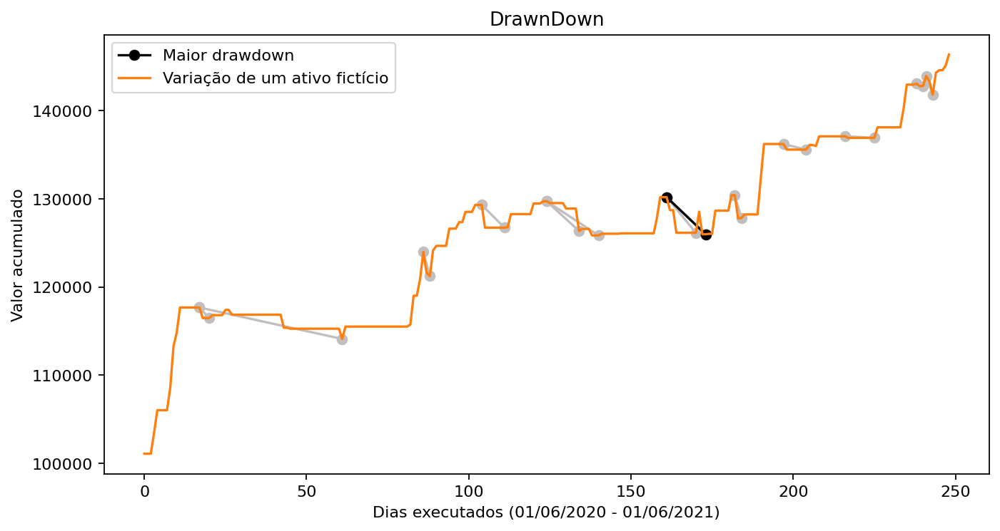

Mostrando média das estatística
Brute Return: 146385.28
Annual Return:46.42
Max DD: 3.23
Mean Trades: 0.29
-----------------------------
finalMoneyNp [146385.28]
annualReturnNp [46.42]
DDmaxNp [3.23]
tradesMeanNp [0.29]


In [103]:
import sys
import pickle
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

tickerNotAnalyzed= ['VALE3','WEGE3'] 

ticker = 'PETR4'
NUM_ATTEMPTS = 1
samplingRateList = [15]
errorMaxList = [0]
errorMinList = [0]
stopLossList = [0.02]
checkEngulfingList = [True]

index = 0
gridSearchResult = {}
for samplingRate in samplingRateList:
    for errorMax in errorMaxList:
        for errorMin in errorMinList:
            for stopLoss in stopLossList:
                for checkEngulfing in checkEngulfingList:
                    key = f'ticker:{ticker}| samplingRate: {samplingRate} | errorMax: {errorMax} | errorMin: {errorMin} | stopLoss: {stopLoss} checkEngulfing:{checkEngulfing}'
                    if(ticker in tickerNotAnalyzed):
                        continue
                    print("###############################################")
                    print(f"Analisando {key}")
                    initialDf = initialDfs[ticker] 
                    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
                    newColumns = ['open', 'high', 'low', 'close']

                    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
                    try:
                        df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M{samplingRate}.csv', sep = "\t")
                    except:
                        print(f"Houve um erro ao carregar arquivo {ticker}_M15.csv")
                    df_INTRA_DAY.columns = dfColumns
                    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
                    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

                    finalMoneyList = []
                    annualReturnList = []
                    DDmaxList = []
                    tradesMeanList = []
                    for tries in range(NUM_ATTEMPTS):
                        verbose = tries == NUM_ATTEMPTS-1
                        
                        _, _,rf, trainColumns, testResult = exp1(initialDf)
                        # testResult = oneLagDay(initialDf)
                        
                        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runLuizStrategy(
                            df=testResult, 
                            dailyDf=df_INTRA_DAY,
                            Money=100000,
                            stopLoss=stopLoss,
                            errorMax=errorMax,
                            errorMin=errorMin,
                            stdMax=None,
                            stdMin=None,
                            alfa=0.0,
                            beta=0.0,
                            method='martinez',
                            checkEngulfing=checkEngulfing,
                            ticker=ticker,
                            verbose=False
                            )
                        
                        finalMoneyList.append(finalMoney)
                        annualReturnList.append(annualReturn)
                        DDmaxList.append(DDmax)
                        tradesMeanList.append(tradesMean)

                        if(verbose):
                            print(f"Mostrando estatística da {tries+1}º execução")
                            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
                            printAmountChart(orders, dfDaily, title = f'{index}-{key}', DDDf=DD)
                    gridSearchResult[key] = {
                        "finalMoneyList": finalMoneyList,
                        "annualReturnList": annualReturnList,
                        "DDmaxList": DDmaxList,
                        "tradesMeanList": tradesMeanList,
                    }
                    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)
                    index+=1

In [85]:
DD
DD['drawdown'].argmax()

3

In [86]:
DD

,maxDay,maxDate,maxValue,minDay,minDate,minValue,drawdown
0,0,2020.06.01,100000.00,4,2020.06.05,99808.00,0.192000
1,18,2020.06.26,104590.00,19,2020.06.29,103540.00,1.003920
2,18,2020.06.26,104590.00,39,2020.07.27,100336.70,4.066641
3,18,2020.06.26,104590.00,55,2020.08.18,98828.98,5.508194
4,90,2020.10.07,105609.98,96,2020.10.16,103520.18,1.978790
5,111,2020.11.09,113694.18,118,2020.11.18,109204.28,3.949103
6,169,2021.02.04,120797.28,184,2021.03.01,117960.14,2.348679
7,197,2021.03.18,124316.14,215,2021.04.14,123733.14,0.468966
8,241,2021.05.21,134454.14,243,2021.05.25,133893.14,0.417243


Media de lucro em casos de trades corretos: 0.30027027027027053
Media de prejuízos em casos de trades errados: -0.22999999999999968
Accuracy( percentagem das operações que tiveram lucros): 64.91


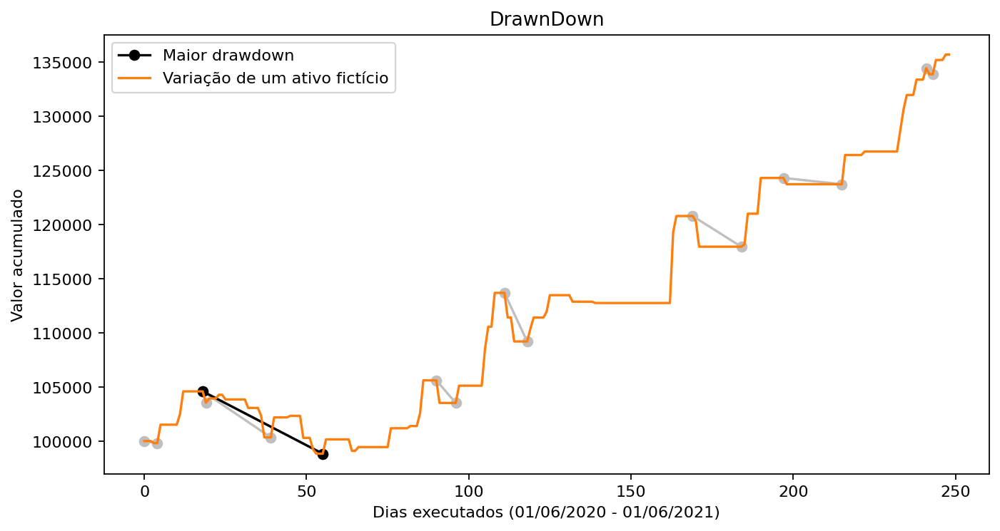

In [94]:
import sys
import pickle
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult
printAmountChart(orders, dfDaily, title = f'{index}-{key}', DDDf=DD)


#### Analisando com taxa de amostragem igual a 15

In [14]:
ticker = 'PETR4'
try:
    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
except:
    print(f"Houve um erro ao carregar arquivo {ticker}_M15.csv")

###############################################
Analisando PETR4
Analisando dia 27
Mostrando estatística da 1º execução
Brute Return: 112853.66
Annual Return:12.86
Max DD: 16.37
Mean Trades: 0.9
-----------------------------
Media de lucro em casos de trades corretos: 0.2970967741935485
Media de prejuízos em casos de trades errados: -0.1833076923076923
Accuracy( percentagem das operações que tiveram lucros): 41.7


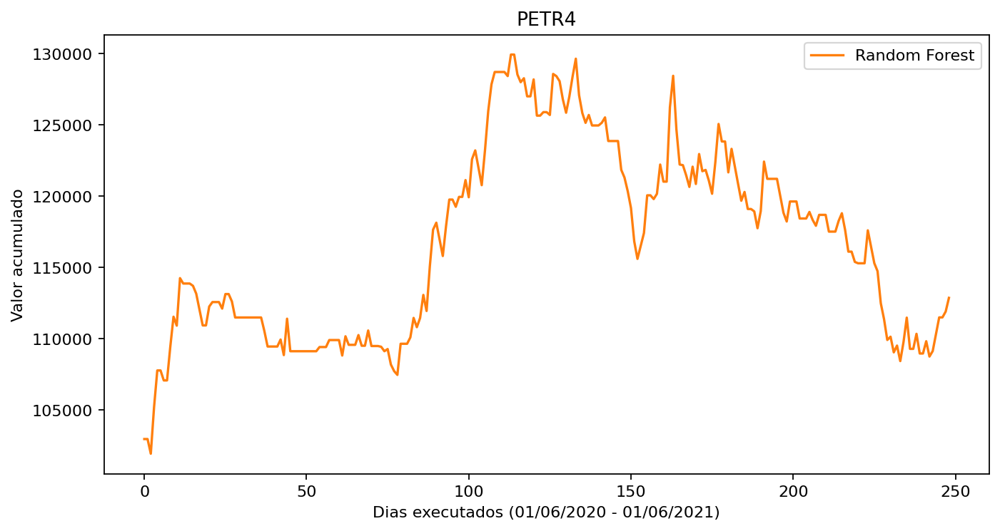

Mostrando média das estatística
Brute Return: 112853.66
Annual Return:12.86
Max DD: 16.37
Mean Trades: 0.9
-----------------------------
finalMoneyNp [112853.66]
annualReturnNp [12.86]
DDmaxNp [16.37]
tradesMeanNp [0.9]
###############################################
Analisando BBDC4
Analisando dia 27
Mostrando estatística da 1º execução
Brute Return: 124269.24
Annual Return:24.29
Max DD: 14.76
Mean Trades: 0.97
-----------------------------
Media de lucro em casos de trades corretos: 0.23211009174311947
Media de prejuízos em casos de trades errados: -0.1456923076923079
Accuracy( percentagem das operações que tiveram lucros): 45.23


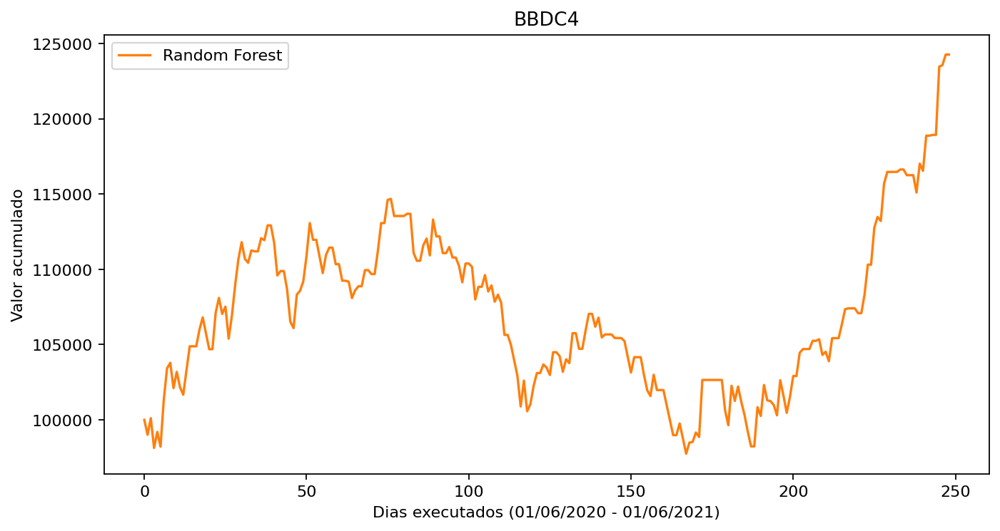

Mostrando média das estatística
Brute Return: 124269.24
Annual Return:24.29
Max DD: 14.76
Mean Trades: 0.97
-----------------------------
finalMoneyNp [124269.24]
annualReturnNp [24.29]
DDmaxNp [14.76]
tradesMeanNp [0.97]
###############################################
Analisando ITUB4
Analisando dia 27


OSError: [Errno 28] No space left on device

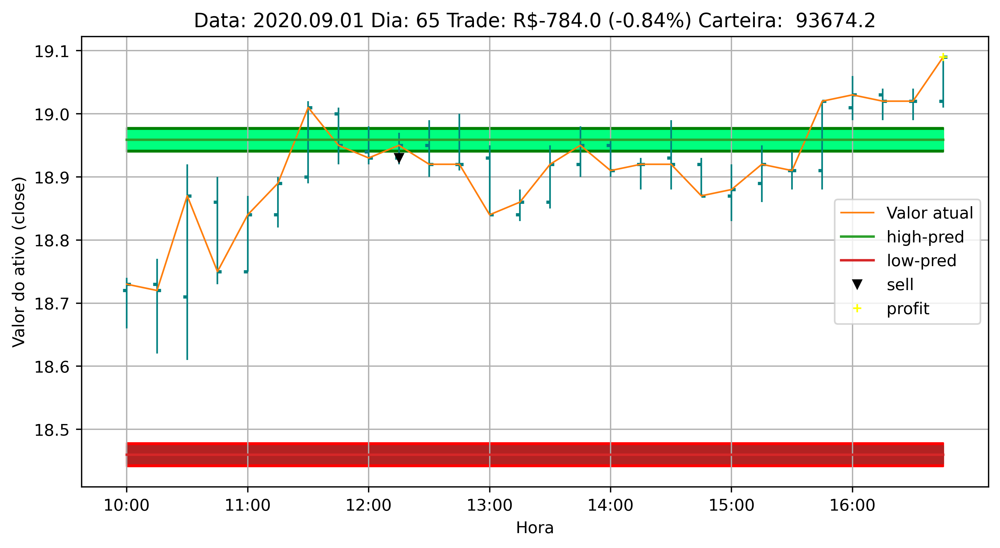

In [45]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)
NUM_ATTEMPTS = 1
for ticker in initialDfs:
    if(ticker in ['VALE3','WEGE3']):
        continue
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runLuizStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.01,
            errorMax=0.001,
            errorMin=0.001,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            checkEngulfing=False,
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)

#### Analisando com taxa de amostragem igual a 5

###############################################
Analisando BBDC4
Analisando dia 80
Mostrando estatística da 1º execução
Brute Return: 137878.01
Annual Return:37.91
Max DD: 13.61
Mean Trades: 1.15
-----------------------------
Media de lucro em casos de trades corretos: 0.2346923076923078
Media de prejuízos em casos de trades errados: -0.16006622516556313
Accuracy( percentagem das operações que tiveram lucros): 45.45


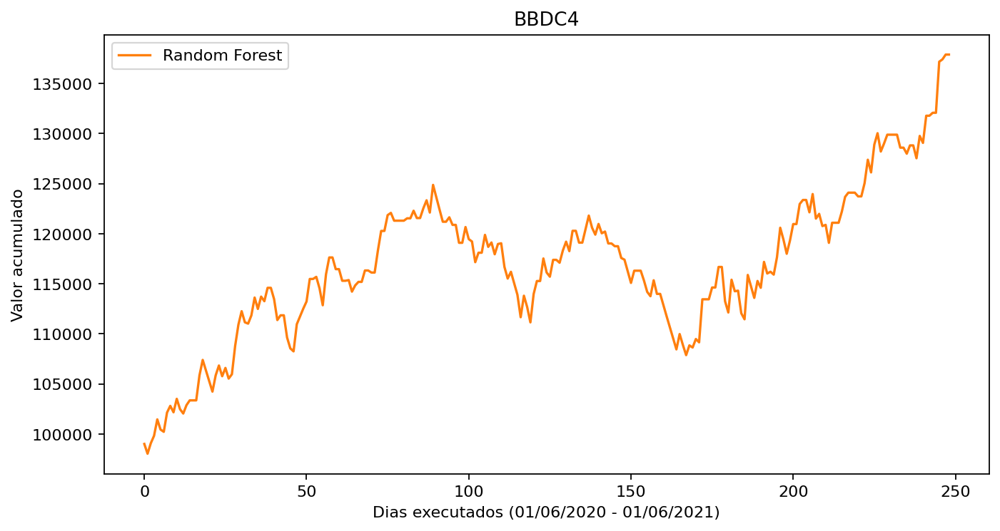

Mostrando média das estatística
Brute Return: 137878.01
Annual Return:37.91
Max DD: 13.61
Mean Trades: 1.15
-----------------------------
finalMoneyNp [137878.01]
annualReturnNp [37.91]
DDmaxNp [13.61]
tradesMeanNp [1.15]
###############################################
Analisando ITUB4
Analisando dia 80
Mostrando estatística da 1º execução
Brute Return: 112065.76
Annual Return:12.07
Max DD: 12.7
Mean Trades: 1.17
-----------------------------
Media de lucro em casos de trades corretos: 0.25149606299212585
Media de prejuízos em casos de trades errados: -0.1804575163398693
Accuracy( percentagem das operações que tiveram lucros): 43.64


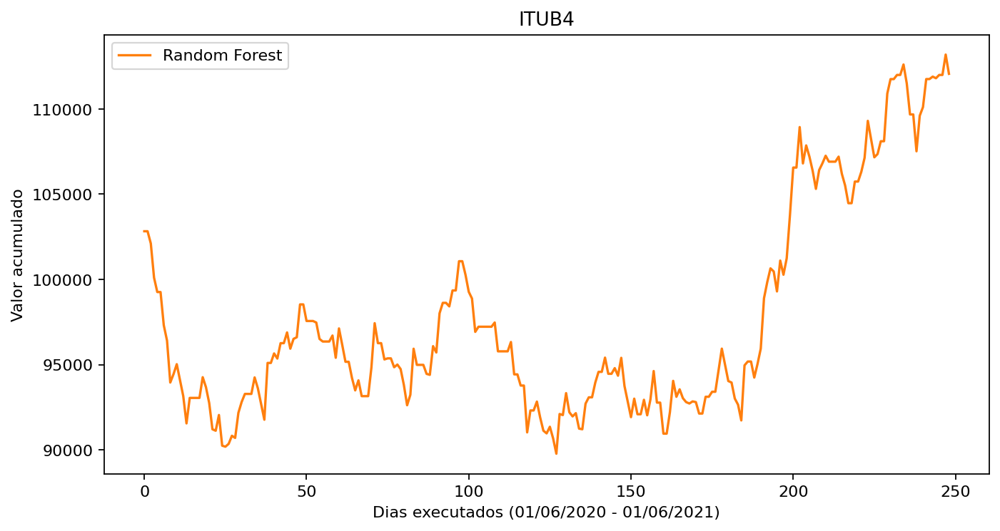

Mostrando média das estatística
Brute Return: 112065.76
Annual Return:12.07
Max DD: 12.7
Mean Trades: 1.17
-----------------------------
finalMoneyNp [112065.76]
annualReturnNp [12.07]
DDmaxNp [12.7]
tradesMeanNp [1.17]


In [43]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runLuizStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult
NUM_ATTEMPTS = 1
for ticker in initialDfs:
    if(ticker in ['PETR4','VALE3','WEGE3']):
        continue
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runLuizStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.01,
            errorMax=0.001,
            errorMin=0.001,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            checkEngulfing=False,
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)

### Sistema Trader

###############################################
Analisando BBDC4
Mostrando estatística da 1º execução
Brute Return: 107859.0
Annual Return:7.86
Max DD: 10.88
Mean Trades: 1.57
-----------------------------
Media de lucro em casos de trades corretos: 0.22814285714285734
Media de prejuízos em casos de trades errados: -0.045454545454545525
Accuracy( percentagem das operações que tiveram lucros): 17.9


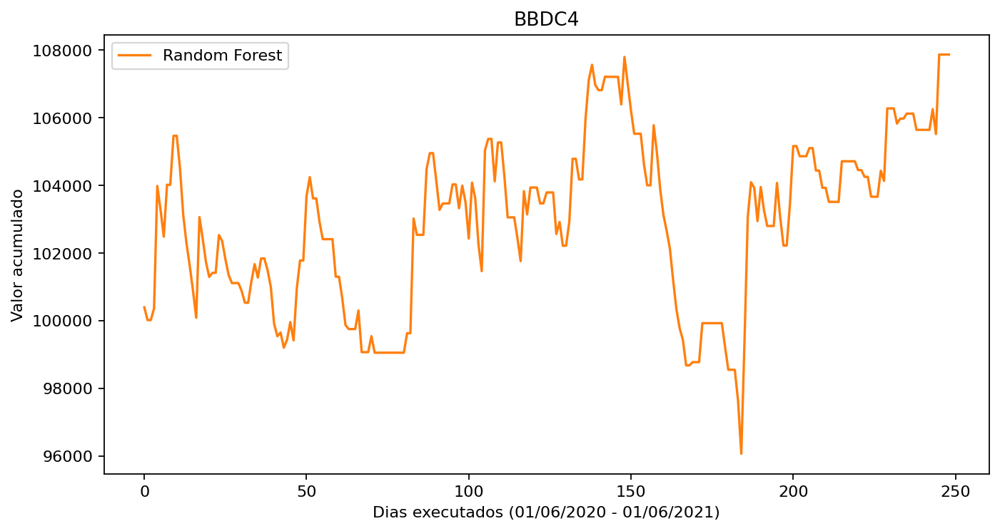

Mostrando média das estatística
Brute Return: 107859.0
Annual Return:7.86
Max DD: 10.88
Mean Trades: 1.57
-----------------------------
finalMoneyNp [107859.]
annualReturnNp [7.86]
DDmaxNp [10.88]
tradesMeanNp [1.57]
###############################################
Analisando ITUB4
Mostrando estatística da 1º execução
Brute Return: 119446.0
Annual Return:19.46
Max DD: 6.32
Mean Trades: 1.68
-----------------------------
Media de lucro em casos de trades corretos: 0.2856000000000002
Media de prejuízos em casos de trades errados: -0.05181286549707595
Accuracy( percentagem das operações que tiveram lucros): 17.94


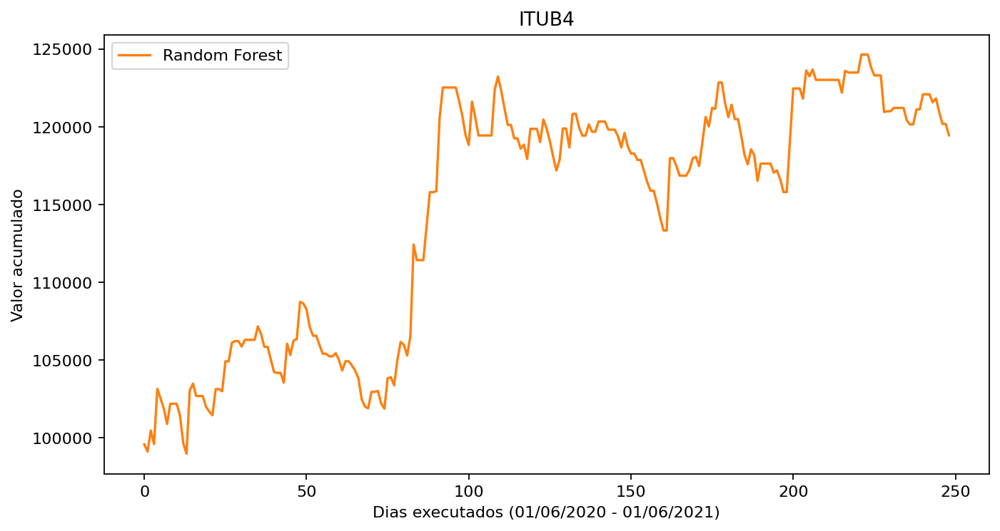

Mostrando média das estatística
Brute Return: 119446.0
Annual Return:19.46
Max DD: 6.32
Mean Trades: 1.68
-----------------------------
finalMoneyNp [119446.]
annualReturnNp [19.46]
DDmaxNp [6.32]
tradesMeanNp [1.68]


In [53]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)
NUM_ATTEMPTS = 1
for ticker in initialDfs:
    if(ticker in ['PETR4','VALE3','WEGE3']):
        continue
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M5.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.001,
            errorMax=None,
            errorMin=None,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            checkEngulfing=True,
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)

###############################################
Analisando WEGE3
Mostrando estatística da 10º execução
Brute Return: 136373.0
Annual Return:36.4
Max DD: 19.07
Mean Trades: 2.39
-----------------------------
Media de lucro em casos de trades corretos: 0.7969072164948457
Media de prejuízos em casos de trades errados: -0.12743951612903215
Accuracy( percentagem das operações que tiveram lucros): 16.33


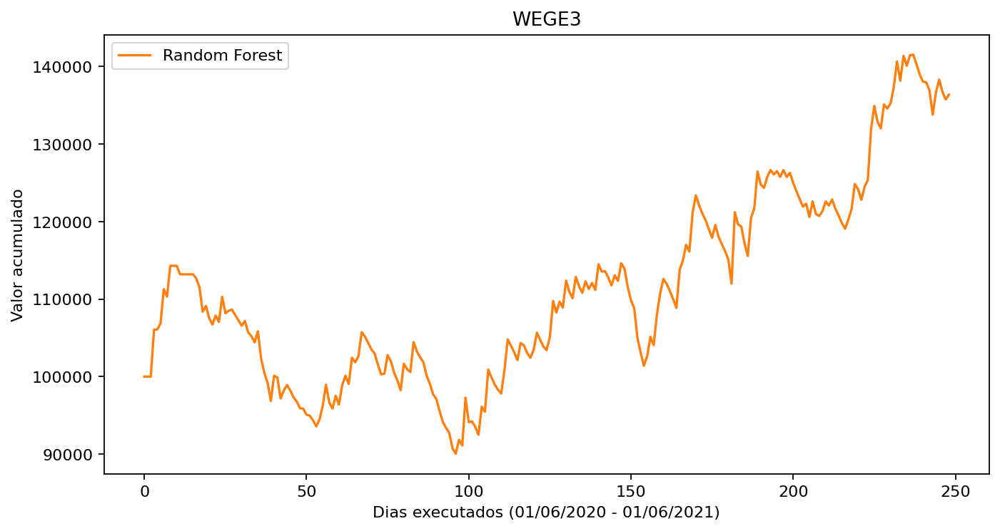

Mostrando média das estatística
Brute Return: 142728.1
Annual Return:42.76200000000001
Max DD: 19.618
Mean Trades: 2.3869999999999996
-----------------------------
finalMoneyNp [137042. 148352. 146573. 137044. 141202. 142258. 149877. 146552. 142008.
 136373.]
annualReturnNp [37.07 48.39 46.61 37.07 41.24 42.29 49.92 46.59 42.04 36.4 ]
DDmaxNp [19.52 19.6  19.68 19.48 19.6  20.35 19.48 19.67 19.73 19.07]
tradesMeanNp [2.39 2.38 2.4  2.38 2.38 2.38 2.39 2.39 2.39 2.39]
###############################################
Analisando BBDC4
Mostrando estatística da 10º execução
Brute Return: 99369.0
Annual Return:-0.63
Max DD: 16.26
Mean Trades: 1.9
-----------------------------
Media de lucro em casos de trades corretos: 0.2624358974358975
Media de prejuízos em casos de trades errados: -0.0509620253164558
Accuracy( percentagem das operações que tiveram lucros): 16.46


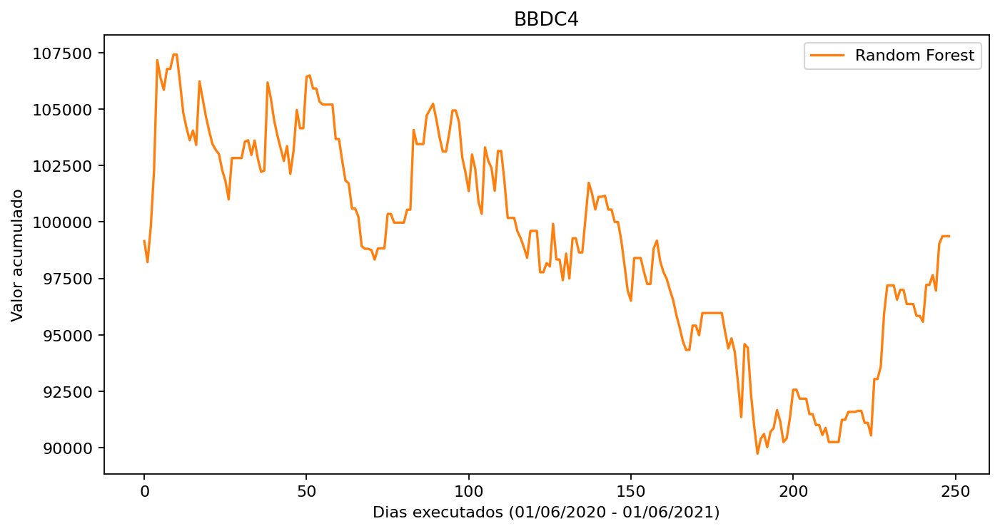

Mostrando média das estatística
Brute Return: 114151.7
Annual Return:14.161000000000001
Max DD: 12.311000000000002
Mean Trades: 1.892
-----------------------------
finalMoneyNp [112369. 106096. 121078. 127084. 111966. 114163. 117106. 112884. 119402.
  99369.]
annualReturnNp [12.38  6.1  21.09 27.1  11.97 14.17 17.12 12.89 19.42 -0.63]
DDmaxNp [14.7  13.51 10.15 11.56  9.09 11.48 11.77 13.25 11.34 16.26]
tradesMeanNp [1.84 1.89 1.91 1.92 1.9  1.88 1.9  1.9  1.88 1.9 ]
###############################################
Analisando ITUB4
Mostrando estatística da 10º execução
Brute Return: 140705.0
Annual Return:40.74
Max DD: 10.62
Mean Trades: 1.96
-----------------------------
Media de lucro em casos de trades corretos: 0.311237113402062
Media de prejuízos em casos de trades errados: -0.05758354755784061
Accuracy( percentagem das operações que tiveram lucros): 19.92


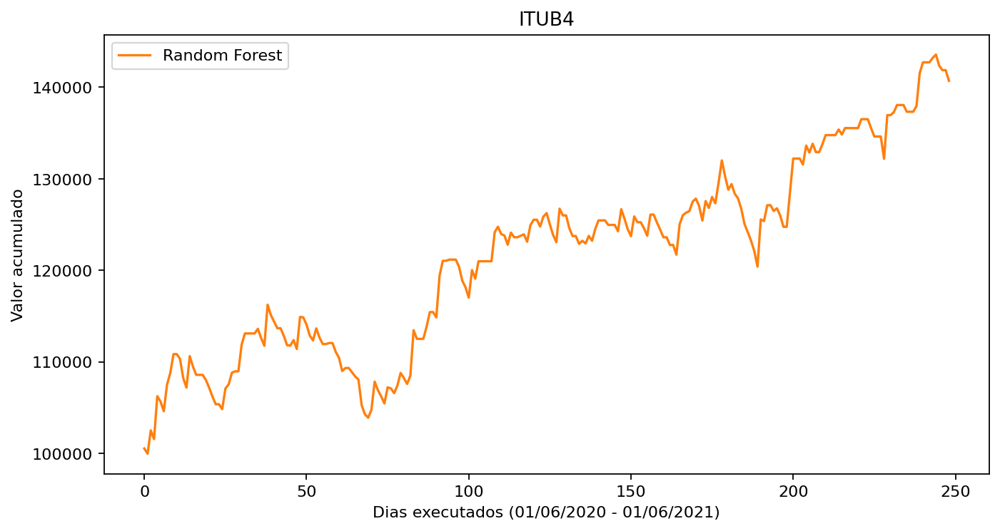

Mostrando média das estatística
Brute Return: 127958.7
Annual Return:27.978999999999996
Max DD: 10.068999999999999
Mean Trades: 1.9580000000000002
-----------------------------
finalMoneyNp [119888. 129499. 131294. 134167. 122532. 120109. 131227. 123022. 127144.
 140705.]
annualReturnNp [19.9  29.52 31.32 34.19 22.55 20.12 31.25 23.04 27.16 40.74]
DDmaxNp [10.51 10.2   8.19 10.74  9.43  9.98  8.43 12.82  9.77 10.62]
tradesMeanNp [1.97 1.95 1.95 1.98 1.94 1.95 1.98 1.94 1.96 1.96]


In [29]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)
NUM_ATTEMPTS = 10
for ticker in initialDfs:
    if(ticker in ['PETR4','VALE3']):
        continue
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M5.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.001,
            errorMax=None,
            errorMin=None,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)

###############################################
Analisando PETR4
Mostrando estatística da 30º execução
Brute Return: 103707.0
Annual Return:3.71
Max DD: 10.93
Mean Trades: 1.46
-----------------------------
Media de lucro em casos de trades corretos: 0.29465909090909087
Media de prejuízos em casos de trades errados: -0.08868131868131877
Accuracy( percentagem das operações que tiveram lucros): 24.24


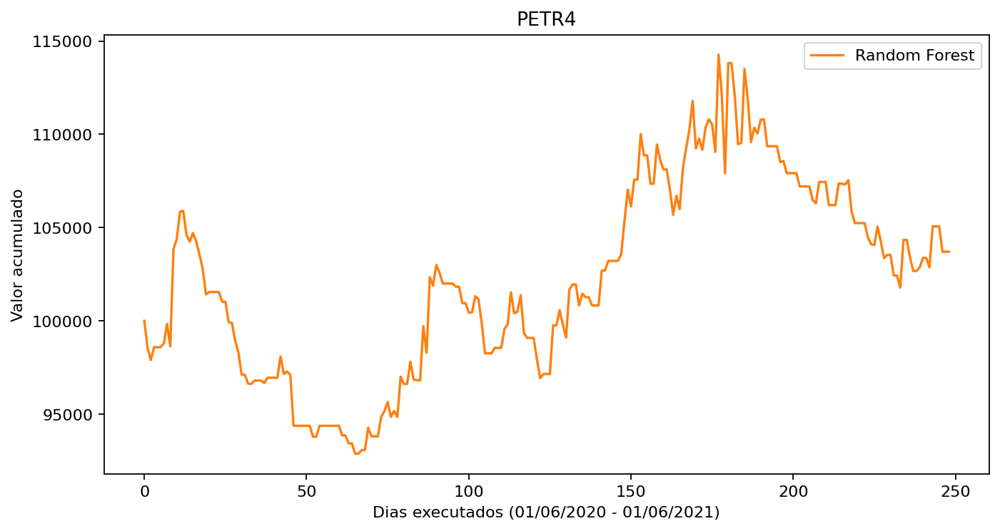

Mostrando média das estatística
Brute Return: 108966.36666666667
Annual Return:8.973
Max DD: 11.375
Mean Trades: 1.471
-----------------------------
finalMoneyNp [103661. 107300. 106094. 104356. 110136. 110118. 113934. 100691.  97874.
 114090. 124248. 110674.  98702. 108021. 111293. 113453. 105577. 104540.
 106292.  99185. 119298. 107741. 121123. 110233. 110408. 112111. 115154.
 112499. 106478. 103707.]
annualReturnNp [ 3.66  7.31  6.1   4.36 10.14 10.13 13.94  0.69 -2.13 14.1  24.27 10.68
 -1.3   8.03 11.3  13.46  5.58  4.54  6.3  -0.82 19.31  7.75 21.14 10.24
 10.42 12.12 15.17 12.51  6.48  3.71]
DDmaxNp [ 9.06 10.13 11.15 13.31 10.96 10.51 11.19 11.46 14.92  9.75 11.49 10.56
 15.95 11.66 11.78 11.67 11.44  9.79 11.39 15.08 10.97 10.79 11.18  9.55
 12.33 11.32  8.31 11.52 11.1  10.93]
tradesMeanNp [1.49 1.47 1.46 1.47 1.47 1.47 1.47 1.47 1.47 1.48 1.46 1.46 1.47 1.47
 1.46 1.47 1.49 1.47 1.47 1.47 1.48 1.48 1.51 1.47 1.46 1.47 1.49 1.45
 1.45 1.46]
###################################

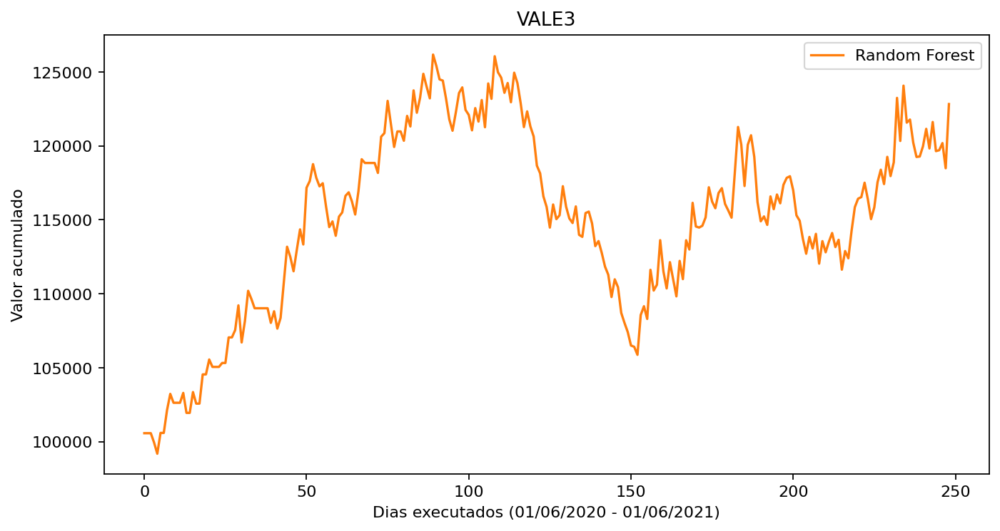

Mostrando média das estatística
Brute Return: 123933.4
Annual Return:23.952
Max DD: 16.088666666666665
Mean Trades: 2.0713333333333335
-----------------------------
finalMoneyNp [123044. 123189. 125622. 125624. 122788. 120334. 122169. 122976. 123060.
 124710. 122901. 125632. 123044. 124560. 127271. 124972. 122913. 122149.
 123052. 125509. 126705. 123185. 125655. 123061. 122950. 125814. 126221.
 123255. 122808. 122829.]
annualReturnNp [23.06 23.21 25.64 25.64 22.81 20.35 22.19 22.99 23.08 24.73 22.92 25.65
 23.06 24.58 27.29 24.99 22.93 22.17 23.07 25.53 26.73 23.2  25.67 23.08
 22.97 25.83 26.24 23.27 22.83 22.85]
DDmaxNp [16.12 16.08 16.   15.97 16.06 16.06 16.25 16.19 16.13 16.03 16.18 15.95
 16.12 16.03 16.11 16.02 16.18 16.25 16.13 15.98 16.1  16.08 15.96 16.13
 16.18 16.07 16.06 16.08 16.07 16.09]
tradesMeanNp [2.07 2.08 2.07 2.08 2.07 2.06 2.07 2.07 2.08 2.07 2.07 2.08 2.08 2.07
 2.08 2.07 2.07 2.06 2.08 2.07 2.07 2.08 2.08 2.06 2.07 2.06 2.07 2.08
 2.06 2.06]
###################

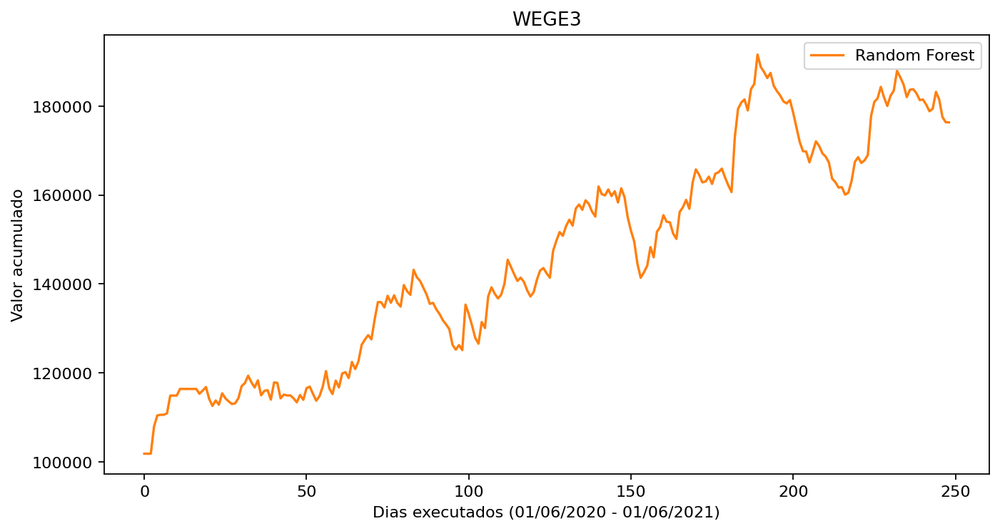

Mostrando média das estatística
Brute Return: 181004.9
Annual Return:81.07766666666666
Max DD: 16.421666666666667
Mean Trades: 2.2696666666666667
-----------------------------
finalMoneyNp [179561. 183235. 184818. 183111. 179580. 183777. 176398. 176245. 175487.
 186473. 175514. 178852. 173978. 185121. 178920. 183243. 183824. 188361.
 176454. 176343. 185146. 179544. 180658. 182688. 184818. 185134. 181034.
 180656. 184831. 176343.]
annualReturnNp [79.63 83.31 84.9  83.19 79.65 83.85 76.47 76.31 75.55 86.55 75.58 78.92
 74.04 85.2  78.99 83.32 83.9  88.44 76.52 76.41 85.22 79.62 80.73 82.76
 84.9  85.21 81.11 80.73 84.91 76.41]
DDmaxNp [16.37 16.45 16.44 16.43 16.37 16.4  16.44 16.43 16.38 16.41 16.38 16.38
 16.46 16.45 16.4  16.45 16.4  16.42 16.44 16.44 16.45 16.37 16.44 16.41
 16.44 16.45 16.43 16.44 16.44 16.44]
tradesMeanNp [2.26 2.27 2.28 2.27 2.27 2.27 2.28 2.27 2.26 2.27 2.27 2.27 2.27 2.27
 2.26 2.27 2.27 2.27 2.26 2.26 2.27 2.27 2.27 2.27 2.28 2.27 2.27 2.27
 2.28 2.27]
########

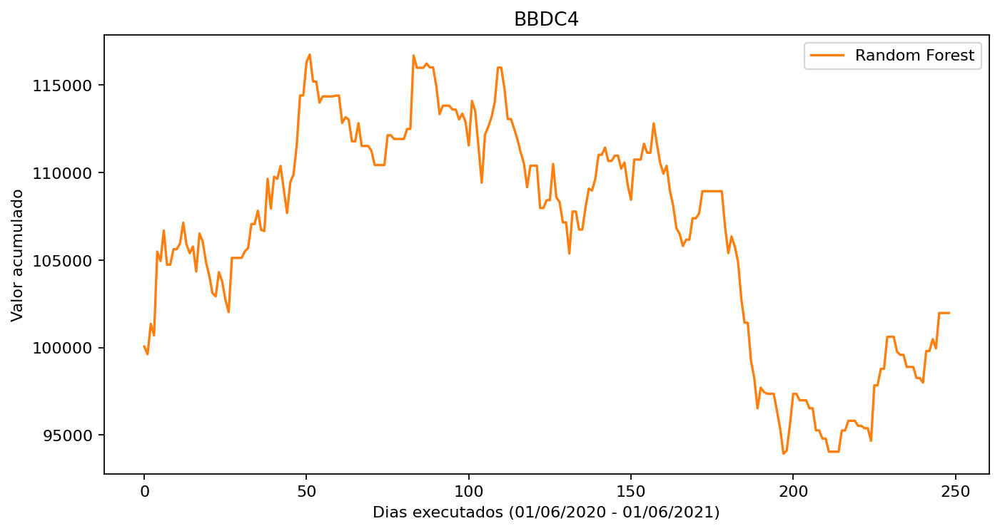

Mostrando média das estatística
Brute Return: 108757.8
Annual Return:8.763666666666667
Max DD: 16.265333333333334
Mean Trades: 1.5243333333333333
-----------------------------
finalMoneyNp [112425. 108940. 110284. 103745. 105216. 113263. 106414. 111539. 109565.
 104784. 101707. 109535. 110677. 106236. 105319. 106068. 110894. 106337.
 100947. 114088. 112698.  99742. 117612. 104142. 111840. 122436. 117502.
 107234. 109573. 101972.]
annualReturnNp [12.43  8.95 10.29  3.75  5.22 13.27  6.42 11.55  9.57  4.79  1.71  9.54
 10.68  6.24  5.32  6.07 10.9   6.34  0.95 14.1  12.71 -0.26 17.63  4.14
 11.85 22.45 17.51  7.24  9.58  1.97]
DDmaxNp [15.43 15.81 17.72 19.53 16.79 15.25 17.69 13.69 15.41 14.14 21.25 15.54
 13.94 13.9  20.12 15.33 15.47 14.68 19.48 11.48 16.49 19.95 16.57 16.8
 15.56 11.78 14.35 15.61 18.68 19.52]
tradesMeanNp [1.52 1.52 1.51 1.5  1.53 1.51 1.49 1.55 1.51 1.53 1.53 1.51 1.53 1.54
 1.52 1.54 1.51 1.55 1.52 1.52 1.52 1.53 1.52 1.51 1.51 1.53 1.54 1.54
 1.53 1.56]
#########

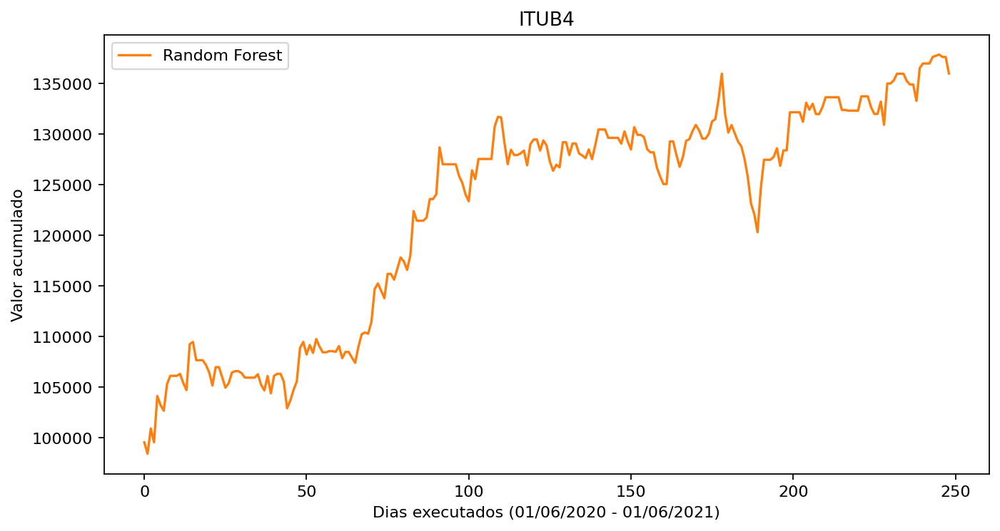

Mostrando média das estatística
Brute Return: 137779.3
Annual Return:37.80866666666667
Max DD: 8.985999999999999
Mean Trades: 1.692
-----------------------------
finalMoneyNp [134441. 131720. 134035. 136793. 137604. 133321. 149380. 124215. 134762.
 140920. 129019. 135871. 131434. 132782. 140723. 138317. 137185. 144821.
 138832. 136355. 140022. 145448. 142945. 142236. 140261. 141676. 129562.
 139775. 152939. 135985.]
annualReturnNp [34.47 31.74 34.06 36.82 37.63 33.35 49.42 24.23 34.79 40.95 29.04 35.9
 31.46 32.81 40.76 38.35 37.21 44.86 38.86 36.38 40.05 45.49 42.98 42.27
 40.29 41.71 29.58 39.81 52.98 36.01]
DDmaxNp [10.34  6.57  9.57  9.97  6.74 10.01 10.03  9.75  6.17  9.8  11.15  5.16
 11.59 10.89  4.8   6.2  11.87 10.11  9.06  4.99 10.13  4.88 10.03 11.84
 11.3   9.74 10.16 10.16  5.05 11.52]
tradesMeanNp [1.71 1.68 1.7  1.71 1.69 1.69 1.67 1.7  1.72 1.71 1.69 1.68 1.71 1.65
 1.66 1.7  1.69 1.69 1.67 1.7  1.68 1.69 1.72 1.69 1.7  1.7  1.69 1.69
 1.71 1.67]


In [10]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)
NUM_ATTEMPTS = 30
for ticker in initialDfs:
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.001,
            errorMax=None,
            errorMin=None,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)


###############################################
Analisando PETR4
Mostrando estatística da 10º execução
Brute Return: 105693.0
Annual Return:5.7
Max DD: 12.27
Mean Trades: 1.49
-----------------------------
Media de lucro em casos de trades corretos: 0.30044444444444435
Media de prejuízos em casos de trades errados: -0.08924460431654681
Accuracy( percentagem das operações que tiveram lucros): 24.32


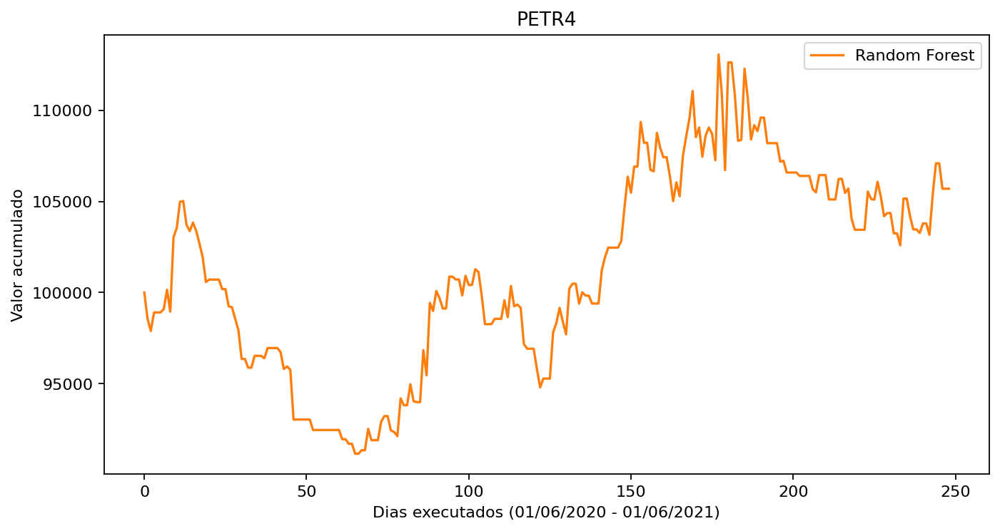

Mostrando média das estatística
Brute Return: 107053.3
Annual Return:7.058000000000002
Max DD: 11.591000000000001
Mean Trades: 1.473
-----------------------------
finalMoneyNp [104857. 106109. 106305. 101412. 106477. 114885. 108451. 112172. 104172.
 105693.]
annualReturnNp [ 4.86  6.11  6.31  1.41  6.48 14.9   8.46 12.18  4.17  5.7 ]
DDmaxNp [10.72 11.31 11.46 17.01 10.49 10.97  9.23 10.83 11.62 12.27]
tradesMeanNp [1.48 1.48 1.47 1.47 1.46 1.47 1.47 1.47 1.47 1.49]
###############################################
Analisando VALE3
Mostrando estatística da 10º execução
Brute Return: 123335.0
Annual Return:23.35
Max DD: 16.09
Mean Trades: 2.07
-----------------------------
Media de lucro em casos de trades corretos: 1.0705737704918035
Media de prejuízos em casos de trades errados: -0.28409669211195904
Accuracy( percentagem das operações que tiveram lucros): 23.69


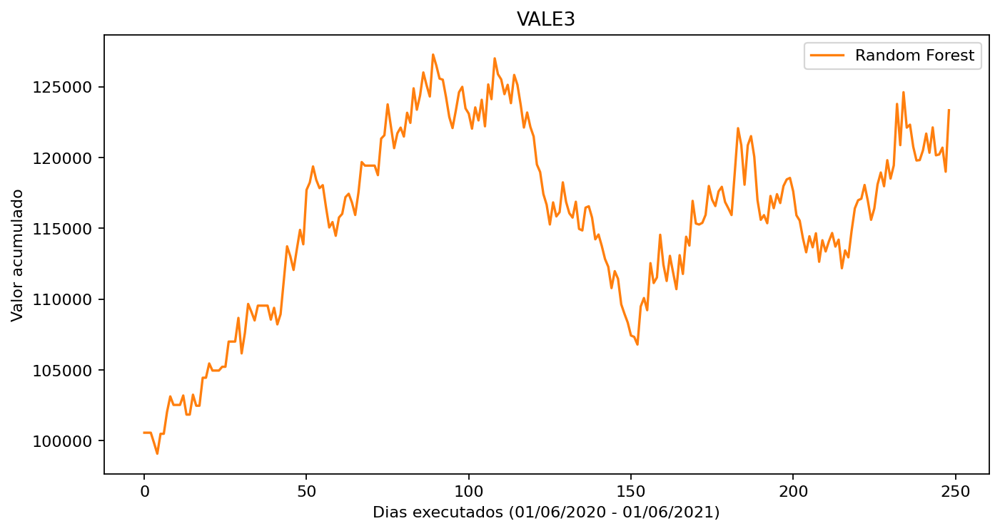

Mostrando média das estatística
Brute Return: 123812.4
Annual Return:23.829
Max DD: 16.121000000000002
Mean Trades: 2.071
-----------------------------
finalMoneyNp [122016. 125641. 122979. 124704. 123075. 125818. 122526. 125685. 122345.
 123335.]
annualReturnNp [22.03 25.66 23.   24.72 23.09 25.84 22.54 25.7  22.36 23.35]
DDmaxNp [16.27 16.   16.13 16.02 16.12 16.   16.25 16.   16.33 16.09]
tradesMeanNp [2.06 2.07 2.07 2.07 2.08 2.07 2.07 2.07 2.08 2.07]
###############################################
Analisando WEGE3
Mostrando estatística da 10º execução
Brute Return: 185408.0
Annual Return:85.49
Max DD: 16.45
Mean Trades: 2.28
-----------------------------
Media de lucro em casos de trades corretos: 0.6890076335877863
Media de prejuízos em casos de trades errados: -0.1541972477064219
Accuracy( percentagem das operações que tiveram lucros): 23.1


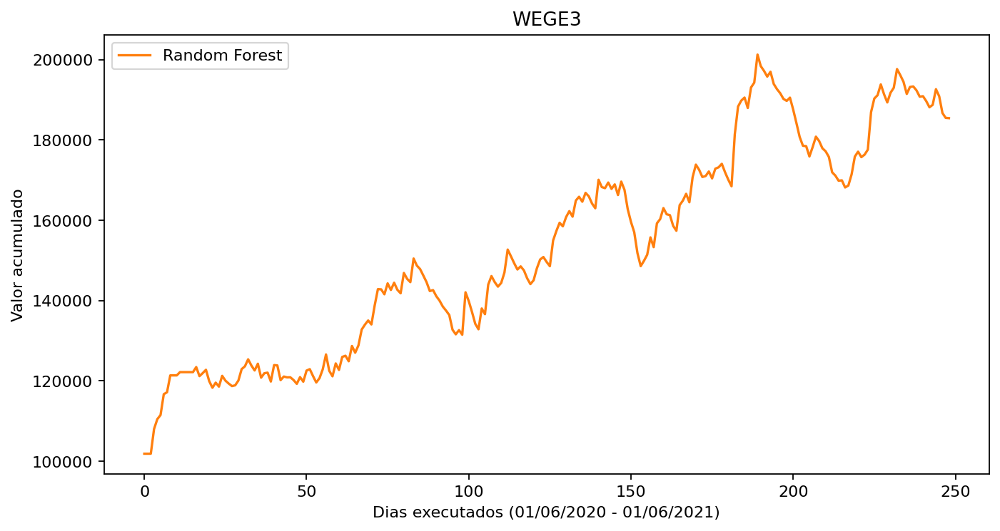

Mostrando média das estatística
Brute Return: 180322.0
Annual Return:80.395
Max DD: 16.406
Mean Trades: 2.27
-----------------------------
finalMoneyNp [181119. 175589. 184550. 185121. 179691. 175495. 181127. 171548. 183572.
 185408.]
annualReturnNp [81.19 75.66 84.63 85.2  79.76 75.56 81.2  71.61 83.65 85.49]
DDmaxNp [16.45 16.35 16.42 16.45 16.38 16.38 16.44 16.37 16.37 16.45]
tradesMeanNp [2.27 2.26 2.27 2.27 2.27 2.27 2.27 2.27 2.27 2.28]
###############################################
Analisando BBDC4
Mostrando estatística da 10º execução
Brute Return: 116797.0
Annual Return:16.81
Max DD: 10.17
Mean Trades: 1.53
-----------------------------
Media de lucro em casos de trades corretos: 0.23924731182795694
Media de prejuízos em casos de trades errados: -0.06659649122807033
Accuracy( percentagem das operações que tiveram lucros): 24.47


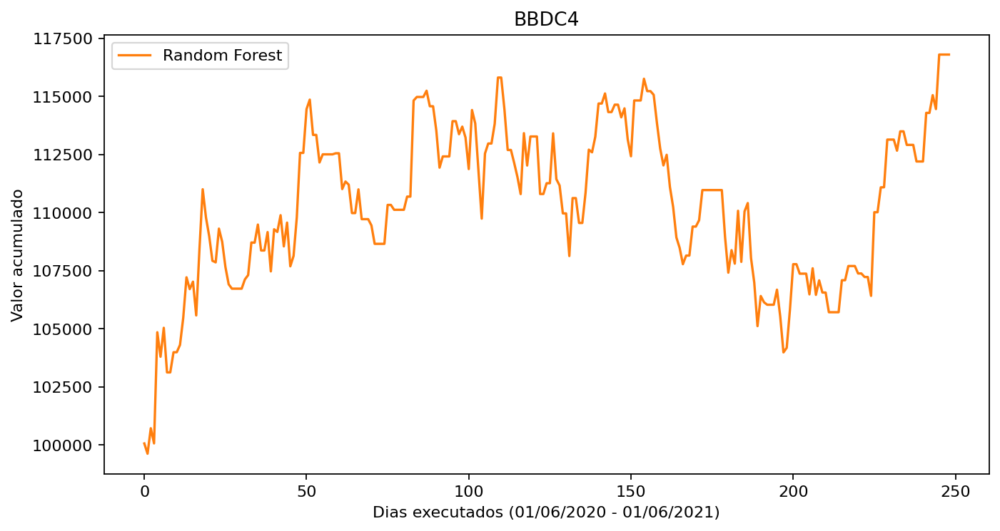

Mostrando média das estatística
Brute Return: 109629.9
Annual Return:9.637
Max DD: 14.386
Mean Trades: 1.5259999999999998
-----------------------------
finalMoneyNp [116688. 113042. 105226. 110445. 111952. 112666. 107897. 101928.  99658.
 116797.]
annualReturnNp [16.7  13.05  5.23 10.45 11.96 12.68  7.9   1.93 -0.34 16.81]
DDmaxNp [11.43 14.25 15.62 15.67 13.03 14.55 13.94 16.52 18.68 10.17]
tradesMeanNp [1.55 1.53 1.51 1.51 1.52 1.53 1.54 1.52 1.52 1.53]
###############################################
Analisando ITUB4
Mostrando estatística da 10º execução
Brute Return: 147045.0
Annual Return:47.08
Max DD: 7.21
Mean Trades: 1.7
-----------------------------
Media de lucro em casos de trades corretos: 0.28064814814814804
Media de prejuízos em casos de trades errados: -0.0702555910543132
Accuracy( percentagem das operações que tiveram lucros): 25.53


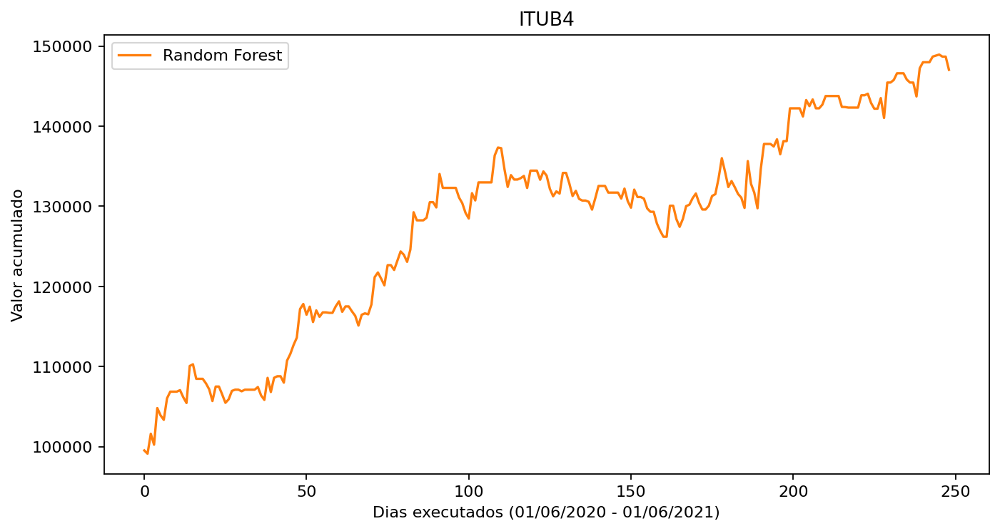

Mostrando média das estatística
Brute Return: 138281.7
Annual Return:38.31099999999999
Max DD: 9.972
Mean Trades: 1.691
-----------------------------
finalMoneyNp [139789. 128505. 137487. 151970. 141231. 126992. 129132. 139013. 141653.
 147045.]
annualReturnNp [39.82 28.53 37.52 52.01 41.26 27.01 29.15 39.04 41.69 47.08]
DDmaxNp [ 9.97 11.08  7.4   6.59 11.85 11.83 11.6  11.82 10.37  7.21]
tradesMeanNp [1.7  1.69 1.72 1.67 1.68 1.71 1.69 1.66 1.69 1.7 ]


In [96]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart, printMeanStrategyResult

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)
NUM_ATTEMPTS = 10
for ticker in initialDfs:
    print("###############################################")
    print(f"Analisando {ticker}")
    initialDf = initialDfs[ticker] 
    dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
    newColumns = ['open', 'high', 'low', 'close']

    df_INTRA_DAY = pd.read_csv(f'../Data/{ticker}_M15.csv', sep = "\t")
    df_INTRA_DAY.columns = dfColumns
    df_INTRA_DAY = removeColumns(df_INTRA_DAY, ['tickvol', 'volume','spread'])
    df_INTRA_DAY['time'] = df_INTRA_DAY['time'].apply(lambda x: x[:-3])

    finalMoneyList = []
    annualReturnList = []
    DDmaxList = []
    tradesMeanList = []
    for tries in range(NUM_ATTEMPTS):
        verbose = tries == NUM_ATTEMPTS-1
        errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf)
        orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
            df=testResult, 
            dailyDf=df_INTRA_DAY,
            Money=100000,
            stopLoss=0.001,
            errorMax=None,
            errorMin=None,
            stdMax=None,
            stdMin=None,
            alfa=0.0,
            beta=0.0,
            method='martinez',
            ticker=ticker,
            verbose=verbose
            )
        
        finalMoneyList.append(finalMoney)
        annualReturnList.append(annualReturn)
        DDmaxList.append(DDmax)
        tradesMeanList.append(tradesMean)

        if(verbose):
            print(f"Mostrando estatística da {tries+1}º execução")
            printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
            printAmountChart(orders, dfDaily, ticker)
    printMeanStrategyResult(finalMoneyList, annualReturnList, DDmaxList, tradesMeanList)


Se escolhermos E_max +  teta_max = 0.34 e E_min +  teta_min = 0.24 conforme encontrado nas células acima, então  o resultado fica igual ao do TCC de Adrion
- runStrategy(testResult, PETR_df_M15, 100000, 0.001, 0.34, 0.24) 

Brute Return: 227168.0
Annual Return:127.3
Max DD: 8.97
Mean Trades: 2.69
#####################################
Media de lucro em casos de trades corretos: 0.33235602094240835
Media de prejuízos em casos de trades errados: -0.09023157894736847
Accuracy( percentagem das operações que tiveram lucros): 28.51


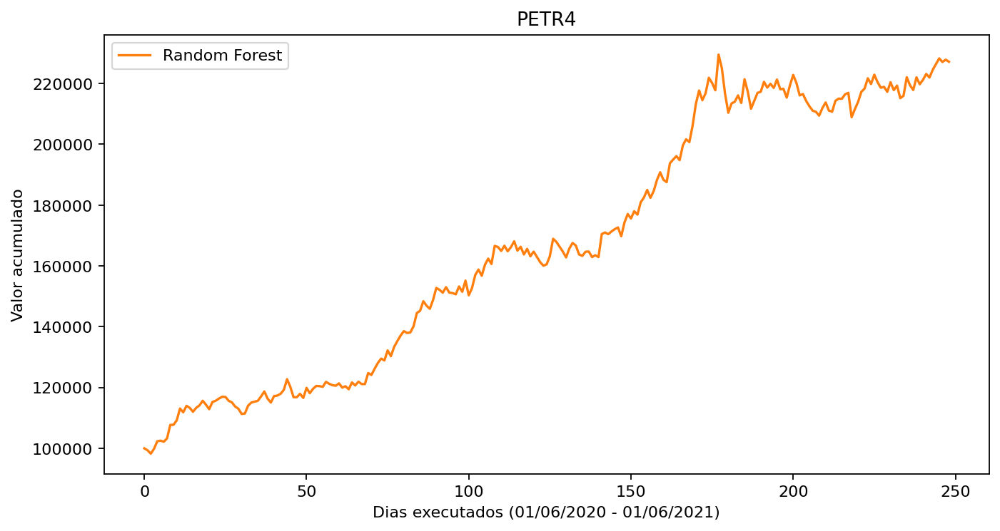

In [25]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)

dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
newColumns = ['open', 'high', 'low', 'close']

PETR_df_M15 = pd.read_csv('../Data/PETR4_M15.csv', sep = "\t")
PETR_df_M15.columns = dfColumns
PETR_df_M15 = removeColumns(PETR_df_M15, ['tickvol', 'volume','spread'])
PETR_df_M15['time'] = PETR_df_M15['time'].apply(lambda x: x[:-3])

errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf_PETR4)
# orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(testResult, PETR_df_M15, 100000, 0.001, 0.02, 0.02)
orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
    df=testResult, 
    dailyDf=PETR_df_M15,
    Money=100000,
    stopLoss=0.001,
    errorMax=None,
    errorMin=None,
    stdMax=None,
    stdMin=None,
    alfa=0.5,
    beta=0.1,
    method='martinez'
    )

printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
printAmountChart(orders, dfDaily)


Brute Return: 127758.0
Annual Return:27.78
Max DD: 14.87
Mean Trades: 8.29
#####################################
Media de lucro em casos de trades corretos: 0.07071065989847707
Media de prejuízos em casos de trades errados: -0.06815126050420166
Accuracy( percentagem das operações que tiveram lucros): 47.72


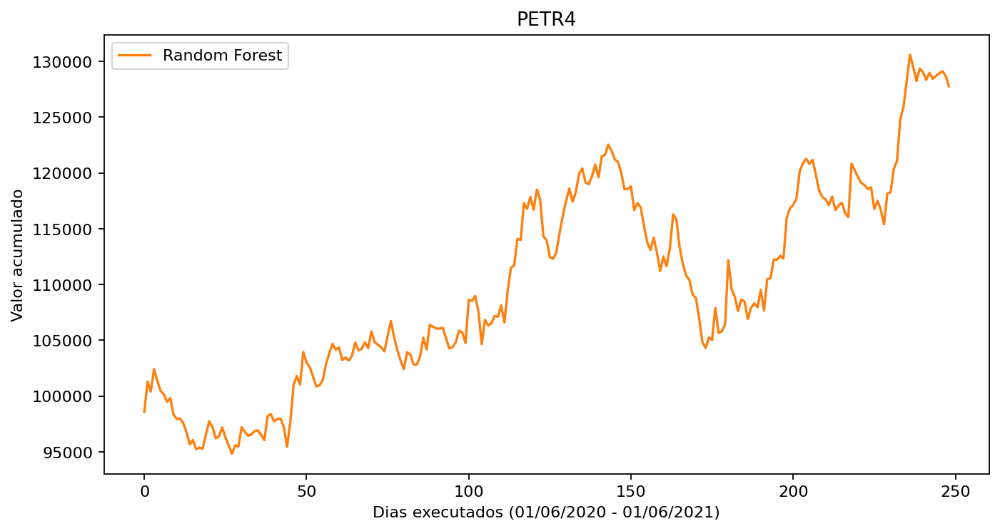

In [30]:
import sys
try:
    del sys.modules["utils"]
except: pass
try:
    del sys.modules["traderSystem"]
except: pass
from utils import exportRegressor, importRegressor
from traderSystem import runStrategy, printStrategyResult, printAmountChart

# rfPath = './myFirstModel.joblib'
# exportRegressor(rf, rfPath)

dfColumns = ['date','time','open', 'high', 'low','close','tickvol','volume','spread']
newColumns = ['open', 'high', 'low', 'close']

PETR_df_M15 = pd.read_csv('../Data/PETR4_M15.csv', sep = "\t")
PETR_df_M15.columns = dfColumns
PETR_df_M15 = removeColumns(PETR_df_M15, ['tickvol', 'volume','spread'])
PETR_df_M15['time'] = PETR_df_M15['time'].apply(lambda x: x[:-3])

errorMax, errorMin,rf, trainColumns, testResult = exp1(initialDf_PETR4)
# orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(testResult, PETR_df_M15, 100000, 0.001, 0.02, 0.02)
orders, dfDaily, DD, DDmax, annualReturn, finalMoney, tradesMean = runStrategy(
    df=testResult, 
    dailyDf=PETR_df_M15,
    Money=100000,
    stopLoss=0.001,
    errorMax=0.34,
    errorMin=0.25,
    stdMax=0.01,
    stdMin=0.0,
    alfa=None,
    beta=None,
    method='adrion'
    )

printStrategyResult(finalMoney, annualReturn, DDmax, tradesMean)
printAmountChart(orders, dfDaily)
